In [8]:
import numpy as np
import matplotlib.pyplot as plt
import time
from collections import defaultdict

import torch
import torch.nn as nn
from torch.nn import functional as F
import torch.utils.data as data_utils
from sklearn.linear_model import LinearRegression, Ridge, RidgeCV, Lasso
import sklearn
from torch.utils.data.sampler import SubsetRandomSampler

import sys,os
sys.path.append(os.path.abspath("/mnt/home/yjo10/ceph/CAMELS/MIEST/utils/"))
from imp import reload 
# Change in mymodule/'
import vib_utils
reload(vib_utils)
from vib_utils import *
import mist_utils
reload(mist_utils)
from mist_utils import *
import umap_utils
reload(umap_utils)
from umap_utils import *

import warnings
warnings.filterwarnings('ignore')

# Device Config
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#device = 'cpu' # temporarily
# Fix random seeds for reproducibility
seed = 73
#torch.manual_seed(seed)
#np.random.seed(seed)a
import sys,os 
import matplotlib.pyplot as plt
import numpy as np
sys.path.append(os.path.abspath("/mnt/home/yjo10/ceph/myutils/"))
from plt_utils import generateAxesForMultiplePlots, remove_inner_axes
from scipy.stats import pearsonr
from sklearn.metrics import mean_squared_error, r2_score
from scipy.stats import chi2_contingency
import optuna
sys.path.append(os.path.abspath("/mnt/home/yjo10/ceph/myutils/"))
import plt_utils as pu
# For mist
fpath = '/mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck'

In [7]:
with torch.no_grad():
    torch.cuda.empty_cache()

In [13]:
import torch
torch.cuda.empty_cache()
import gc
gc.collect()


9080

In [12]:
study_name = 'TNG_SIMBA_ASTRID_HI_cnn_zero_monopole_1_new_split_zdim_4000'
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
path       = f"/mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
if os.path.isfile(path):
    print("file exists!")
    vib_umap = UMAP(sim=['TNG', 'SIMBA', 'ASTRID'],field=field,study_name=study_name, fpath=fpath, z_dim=4000)

file exists!
The AUC score is 0.7187799857296439.
(4500, 3)


$\Omega_m$: MSE=0.000, % error=3.919%, R2 score=0.979,chi2=0.626, bias=0.000
$\sigma_8$: MSE=0.002, % error=4.782%, R2 score=0.847,chi2=1.003, bias=-0.003
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.005, % error=16.981%, R2 score=0.601,chi2=16.115, bias=0.059
$\sigma_8$: MSE=0.012, % error=11.463%, R2 score=0.095,chi2=5.988, bias=-0.068
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.007, % error=22.792%, R2 score=0.486,chi2=19.264, bias=0.021
$\sigma_8$: MSE=0.015, % error=12.151%, R2 score=-0.139,chi2=9.180, bias=0.037


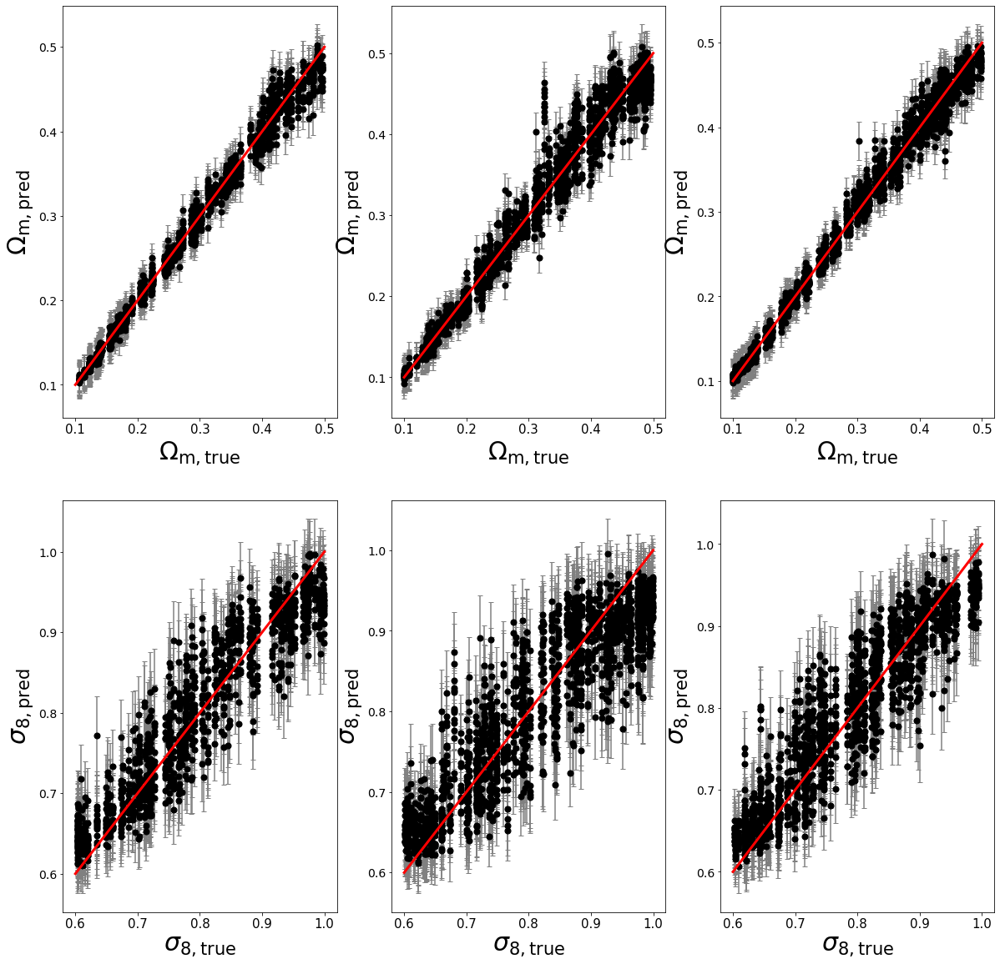

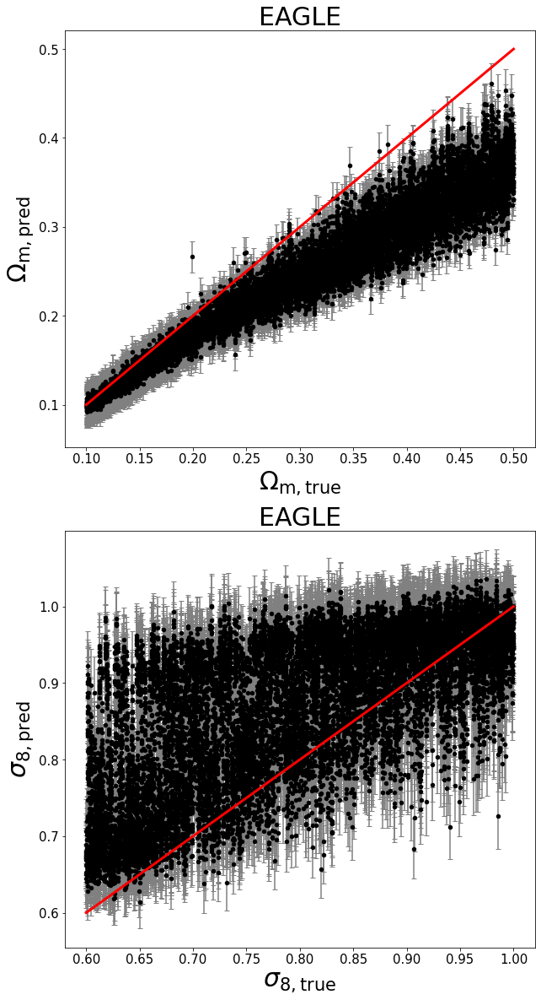

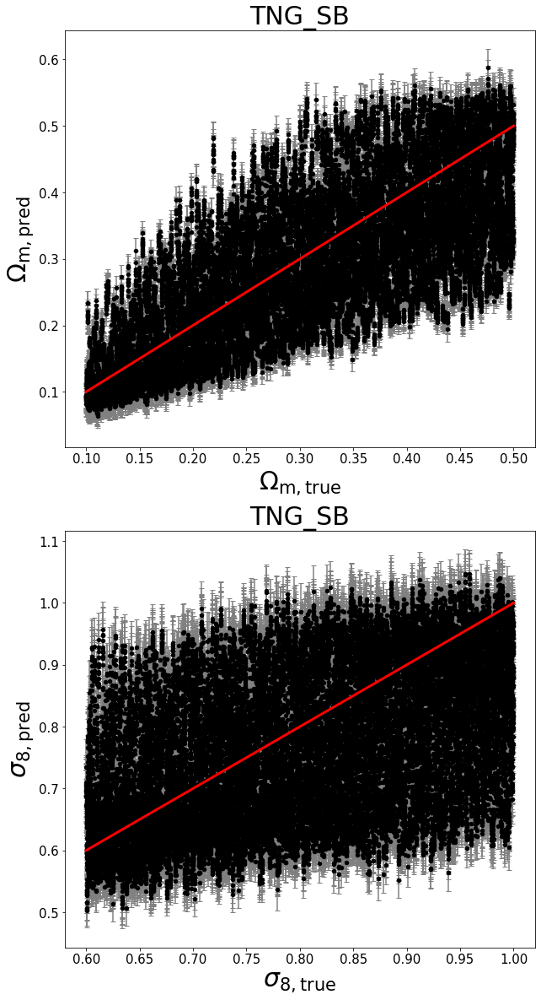

In [3]:
sim  = ['TNG', 'SIMBA', 'ASTRID']; field = 'HI'
study_name = 'TNG_SIMBA_ASTRID_HI_cnn_zero_monopole_1_new_split_zdim_4000'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath,z_dim=4000)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')



$\Omega_m$: MSE=0.000, % error=3.981%, R2 score=0.980,chi2=0.757, bias=0.000
$\sigma_8$: MSE=0.002, % error=4.677%, R2 score=0.853,chi2=1.099, bias=0.002
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.009, % error=21.342%, R2 score=0.354,chi2=34.922, bias=0.074
$\sigma_8$: MSE=0.012, % error=12.068%, R2 score=0.091,chi2=6.564, bias=-0.075
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.007, % error=22.603%, R2 score=0.510,chi2=24.380, bias=0.017
$\sigma_8$: MSE=0.016, % error=12.572%, R2 score=-0.236,chi2=26.558, bias=0.044


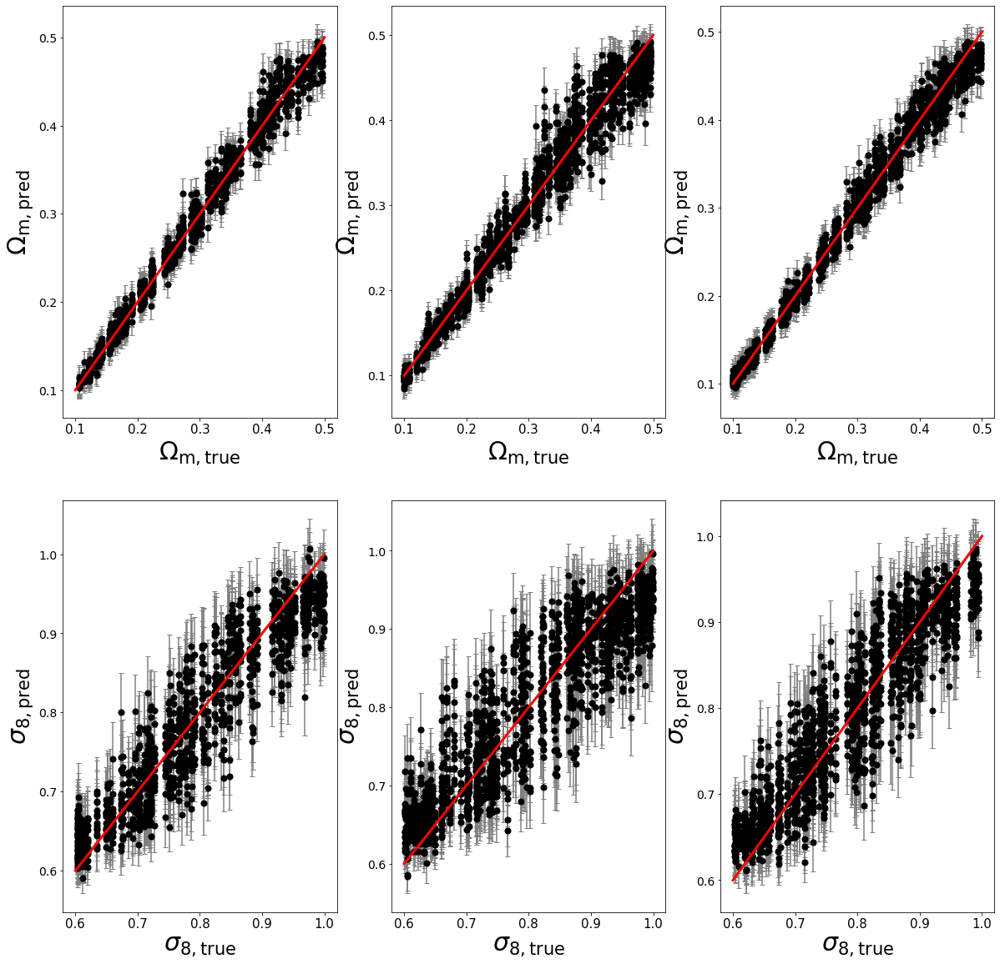

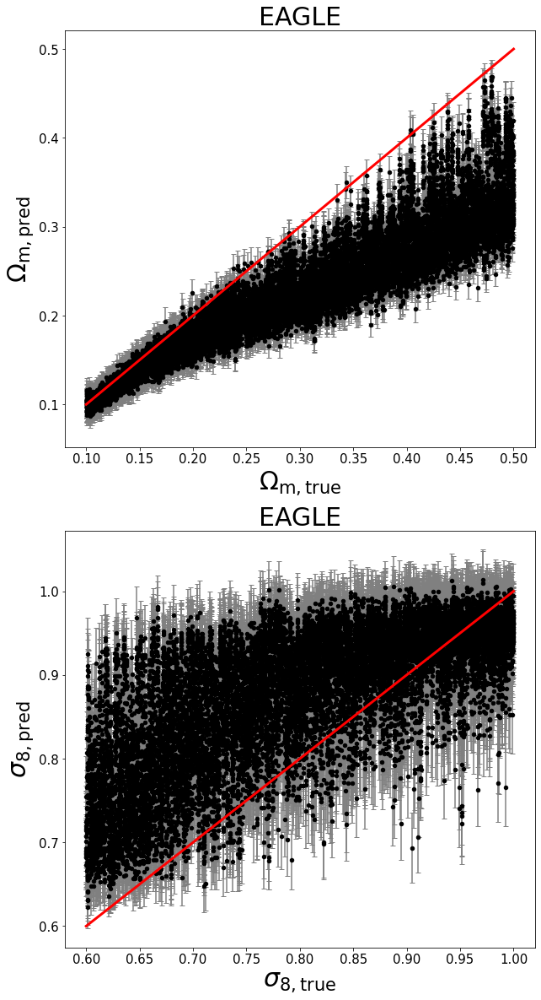

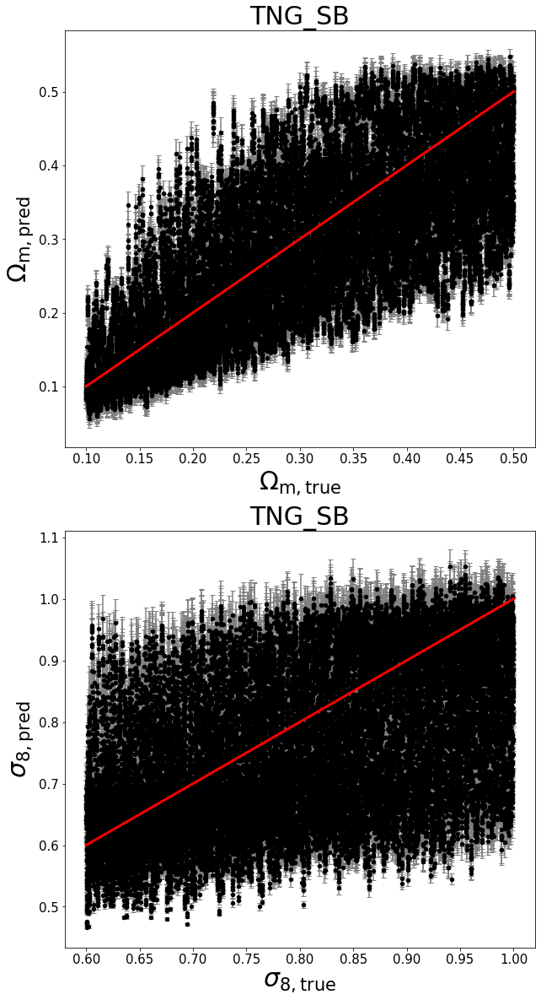

In [14]:
sim  = ['TNG', 'SIMBA', 'ASTRID']; field = 'HI'
study_name = 'TNG_SIMBA_ASTRID_HI_cnn_enc_dec_low_monopole_1'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')



$\Omega_m$: MSE=0.000, % error=5.185%, R2 score=0.972,chi2=0.543, bias=0.001
$\sigma_8$: MSE=0.003, % error=5.372%, R2 score=0.807,chi2=1.044, bias=0.000
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.008, % error=19.838%, R2 score=0.436,chi2=11.529, bias=0.065
$\sigma_8$: MSE=0.013, % error=12.173%, R2 score=0.016,chi2=4.810, bias=-0.063
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.008, % error=23.199%, R2 score=0.435,chi2=11.189, bias=0.023
$\sigma_8$: MSE=0.014, % error=11.621%, R2 score=-0.013,chi2=5.149, bias=0.006


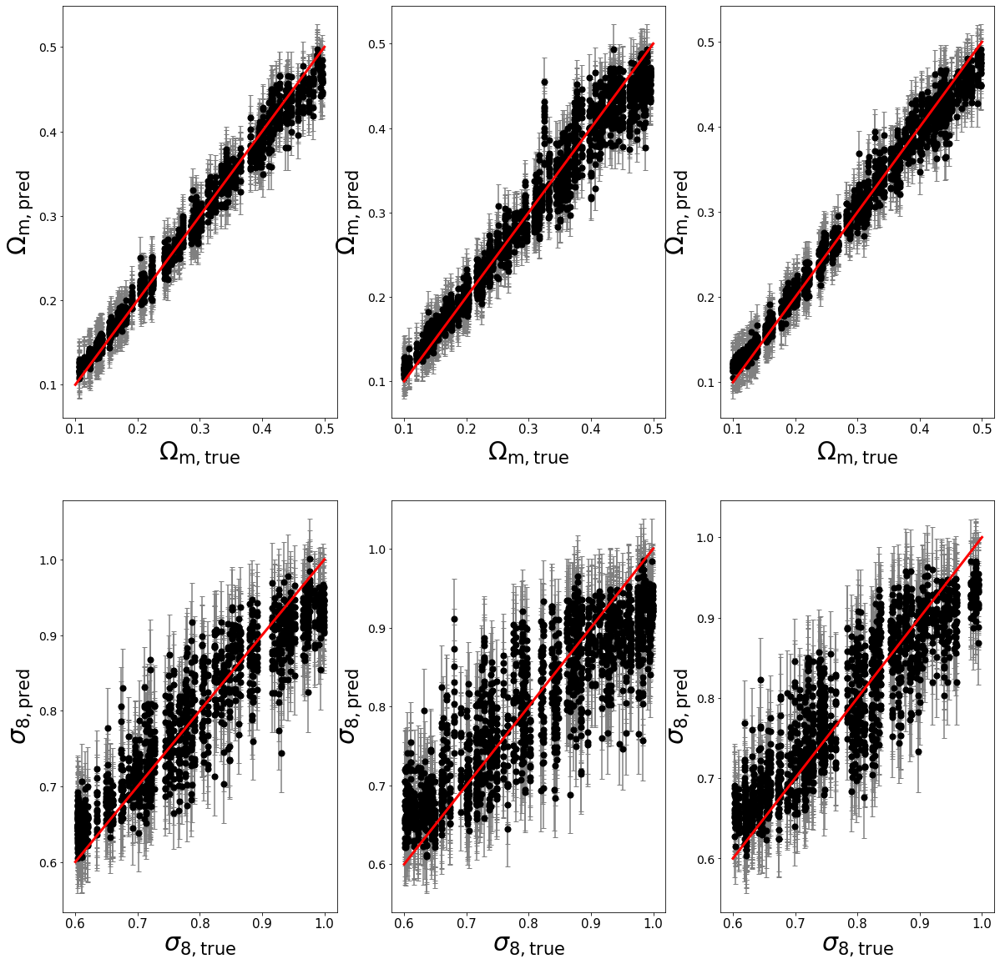

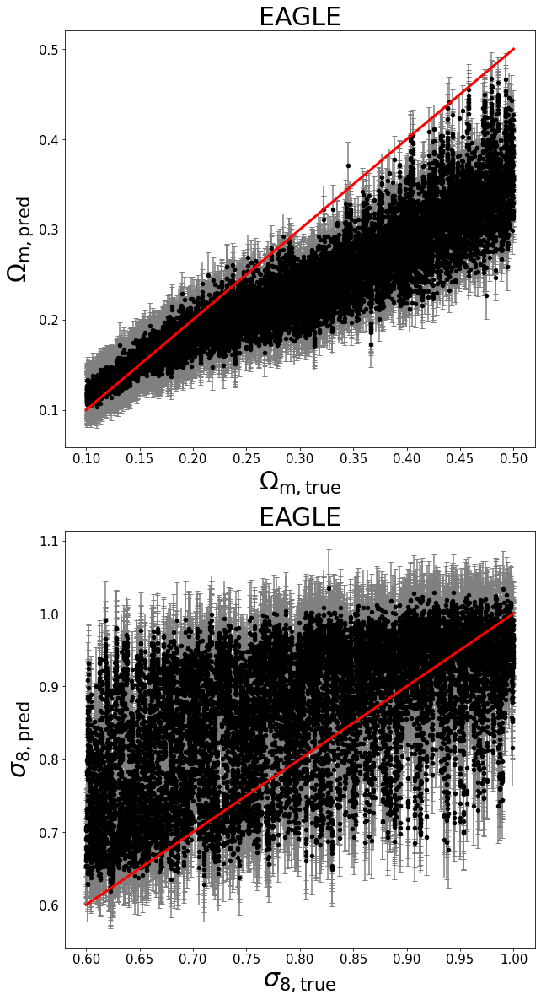

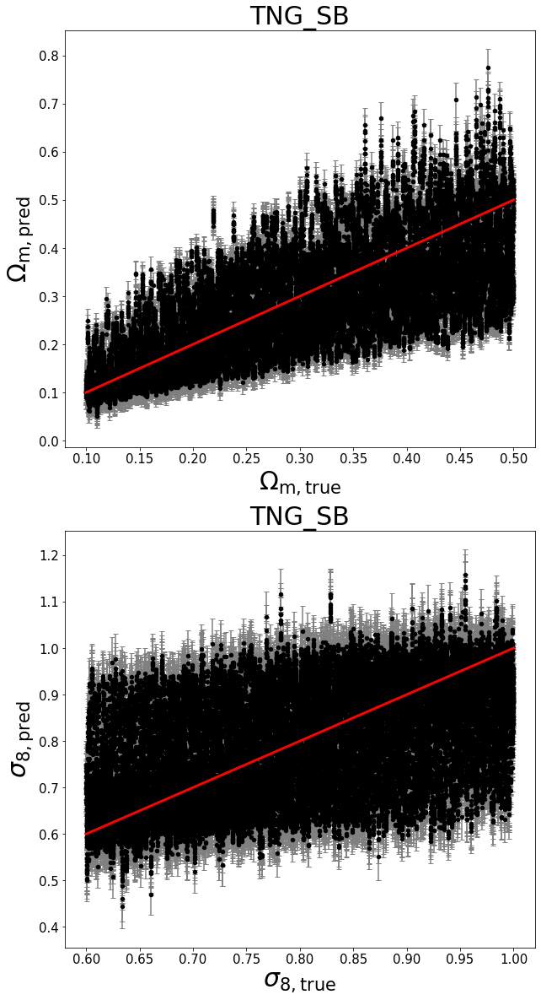

In [6]:
sim  = ['TNG', 'SIMBA', 'ASTRID']; field = 'HI'
study_name = 'TNG_SIMBA_ASTRID_HI_cnn_mid_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')



num_trial=103, params={'dropout': 0.29775219232254824, 'hidden': 5, 'lr': 0.0033619846965411947, 'wd': 6.475034117166248e-05, 'z_dim': 50} 
$\Omega_m$: MSE=0.000, % error=5.544%, R2 score=0.980,chi2=39199538645.816, bias=-0.012
$\sigma_8$: MSE=0.001, % error=3.375%, R2 score=0.921,chi2=1.207, bias=-0.004
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.007, % error=20.240%, R2 score=0.467,chi2=11483261092581734.000, bias=0.025
$\sigma_8$: MSE=0.025, % error=16.644%, R2 score=-0.838,chi2=24.127, bias=-0.084
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.001, % error=7.548%, R2 score=0.928,chi2=74949153231133.844, bias=0.006
$\sigma_8$: MSE=0.021, % error=16.714%, R2 score=-0.572,chi2=21.043, bias=-0.113
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.007, % error=19.531%, R2 score=0.461,chi2=24486458566567244.000, bias=0.067
$\sigma_8$: MSE=0.024, % error=16.939%, R2 score=-0.763,chi2=23.559, bias=-0.122
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.009, % error=24.093%, R2 sc

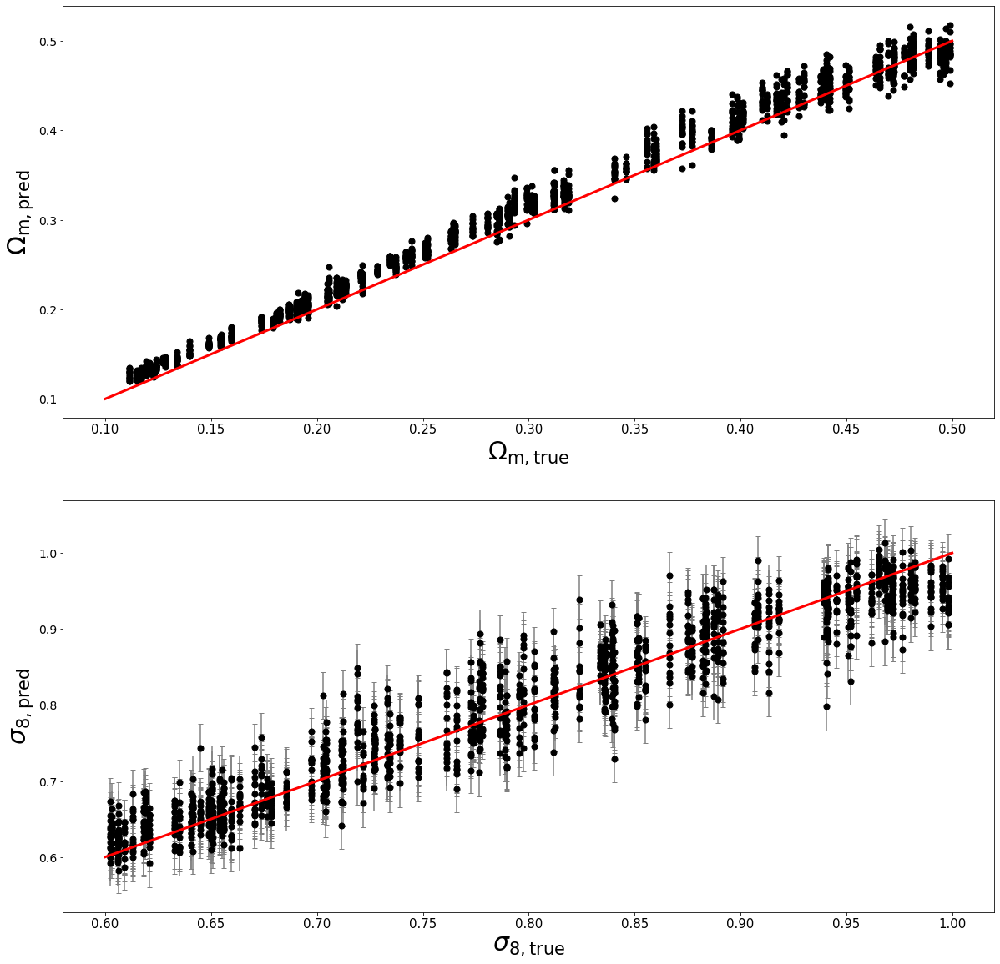

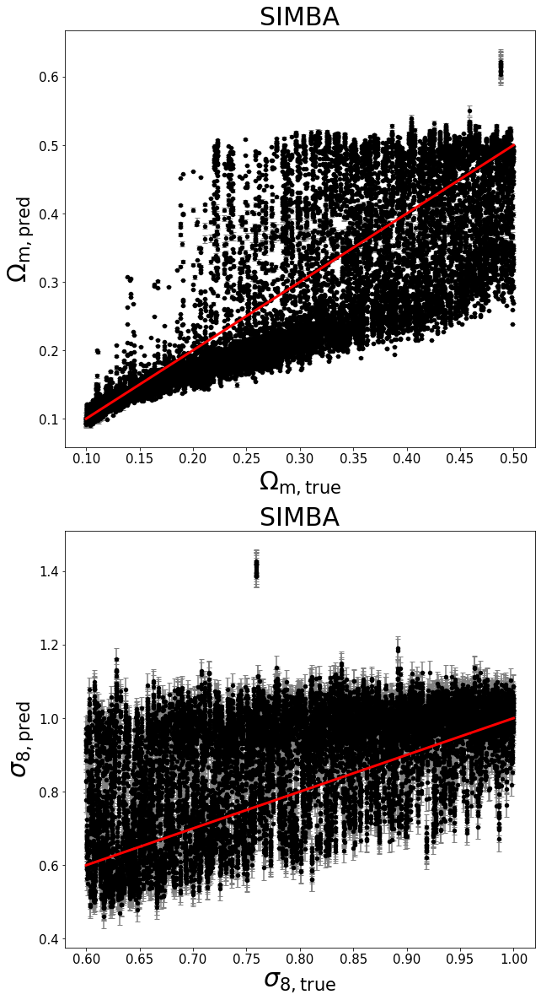

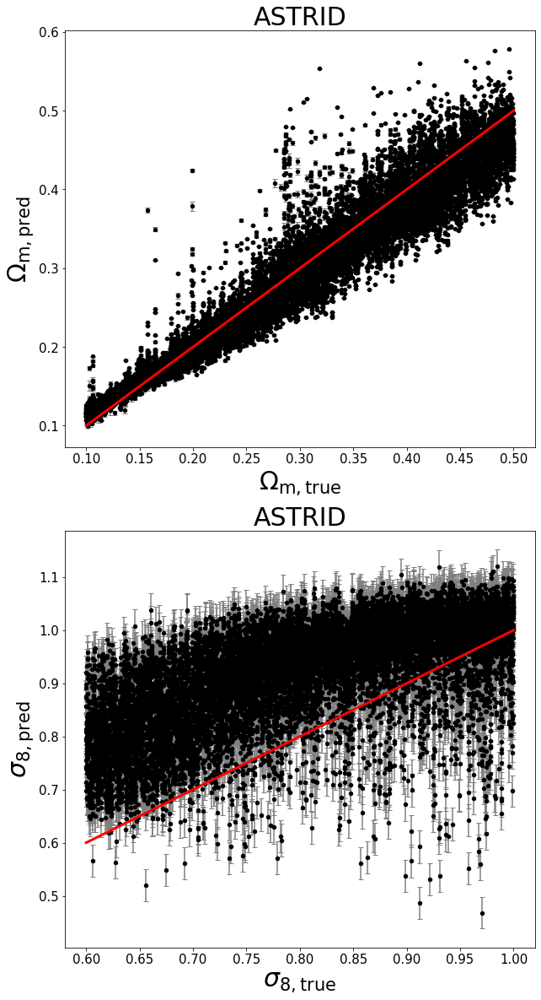

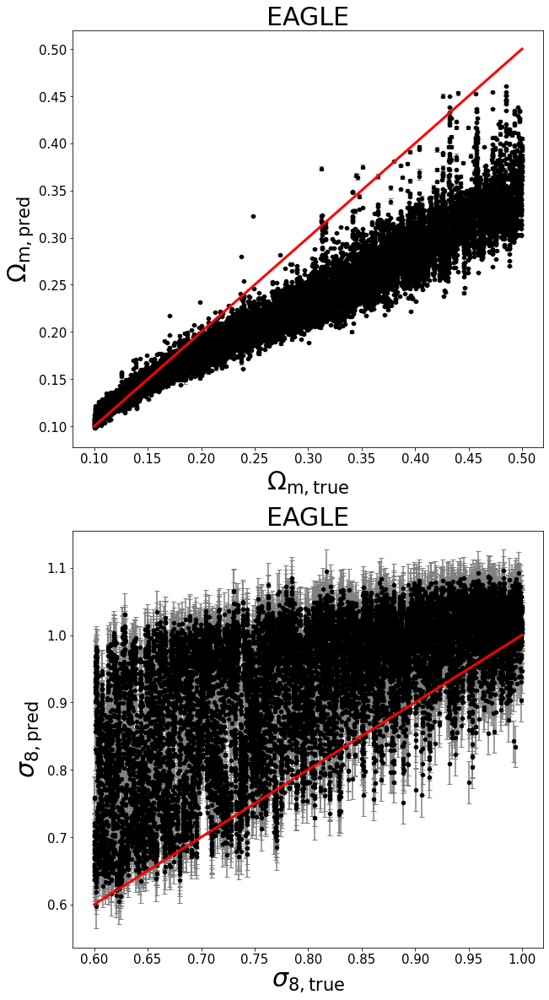

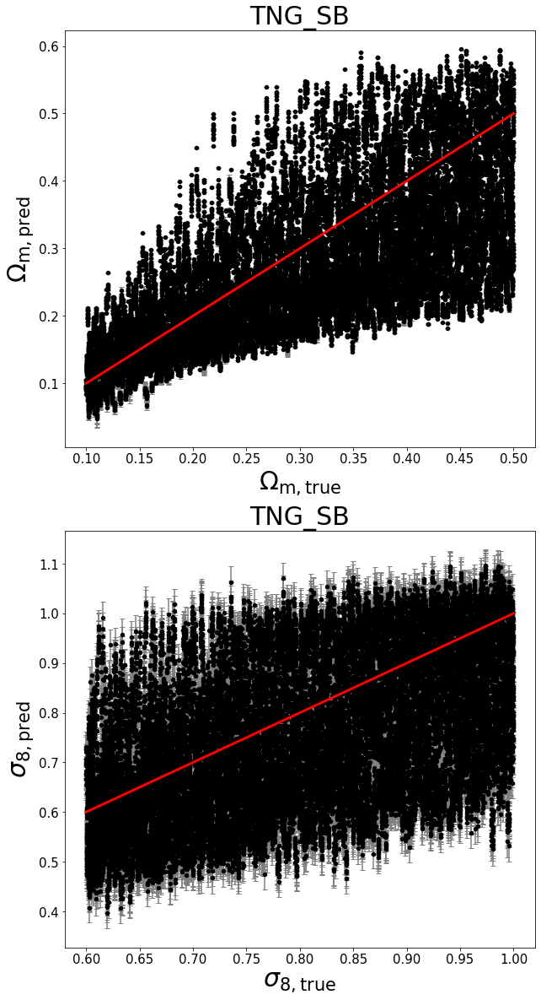

In [12]:
sim  = ['TNG']; field = 'HI'
study_name = 'TNG_HI_cnn_zero_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib_cnn",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('SIMBA', show_score=True)
mist.test_on_cnn('ASTRID', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

num_trial=33, params={'dropout': 0.3596904847435032, 'hidden': 8, 'lr': 0.0015794744416277118, 'wd': 1.7457103362594958e-05, 'z_dim': 1088} 
$\Omega_m$: MSE=0.000, % error=6.101%, R2 score=0.963,chi2=2837791.059, bias=-0.004
$\sigma_8$: MSE=0.004, % error=5.916%, R2 score=0.710,chi2=53.459, bias=-0.002
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.007, % error=28.066%, R2 score=0.467,chi2=852.328, bias=-0.077
$\sigma_8$: MSE=0.015, % error=11.414%, R2 score=-0.144,chi2=336.504, bias=0.061
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.005, % error=24.720%, R2 score=0.618,chi2=839.027, bias=-0.062
$\sigma_8$: MSE=0.036, % error=22.770%, R2 score=-1.728,chi2=361.254, bias=-0.164
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.002, % error=13.317%, R2 score=0.848,chi2=399274186.698, bias=-0.008
$\sigma_8$: MSE=0.015, % error=11.937%, R2 score=-0.111,chi2=438.977, bias=0.014
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.009, % error=26.990%, R2 score=0.359,chi2=3371638335327.5

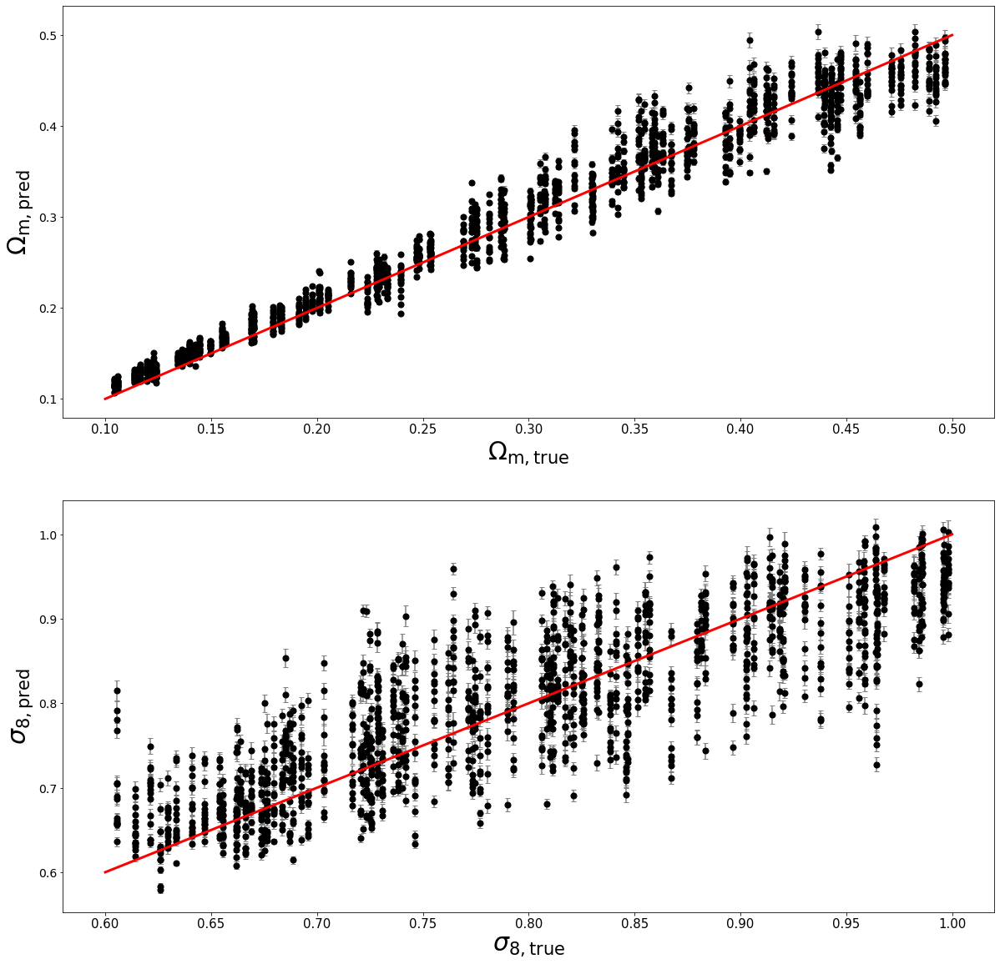

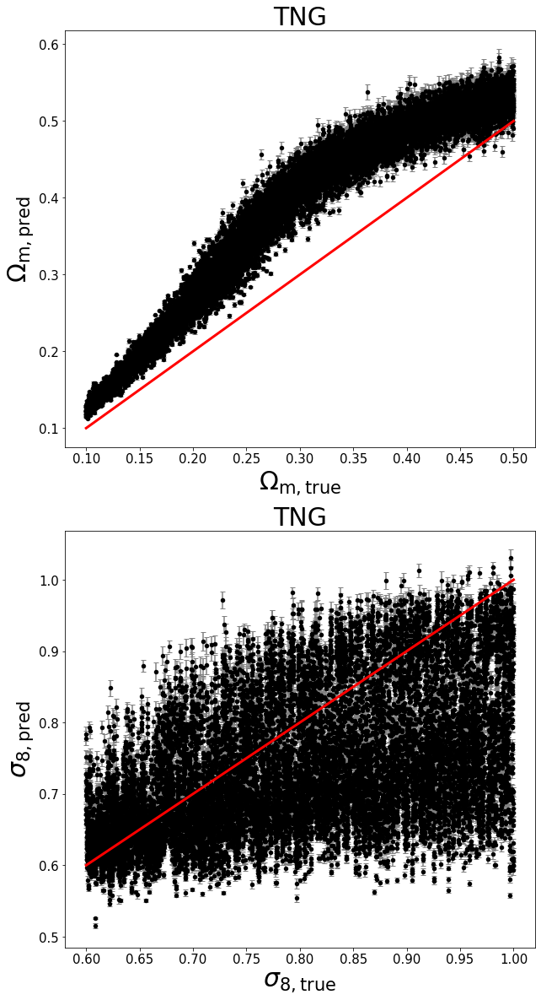

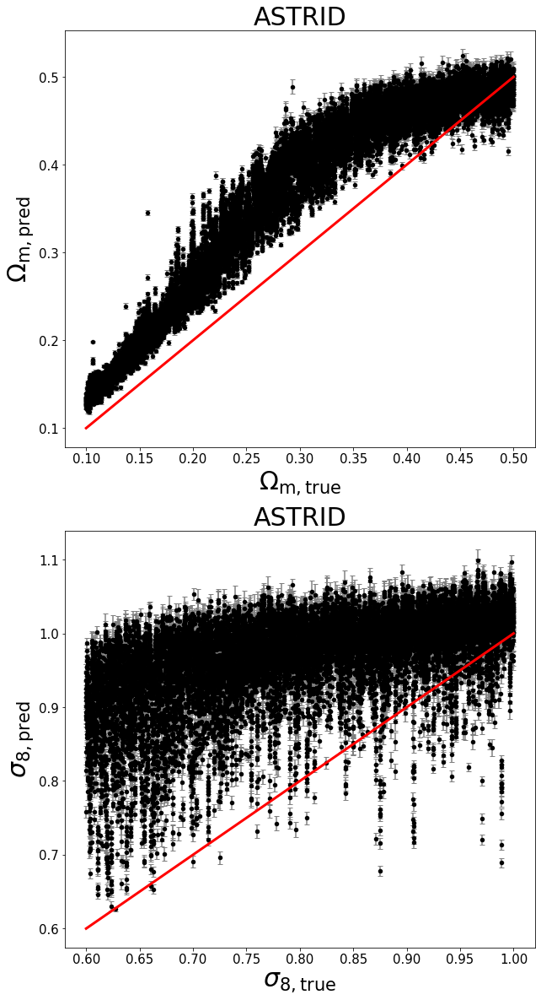

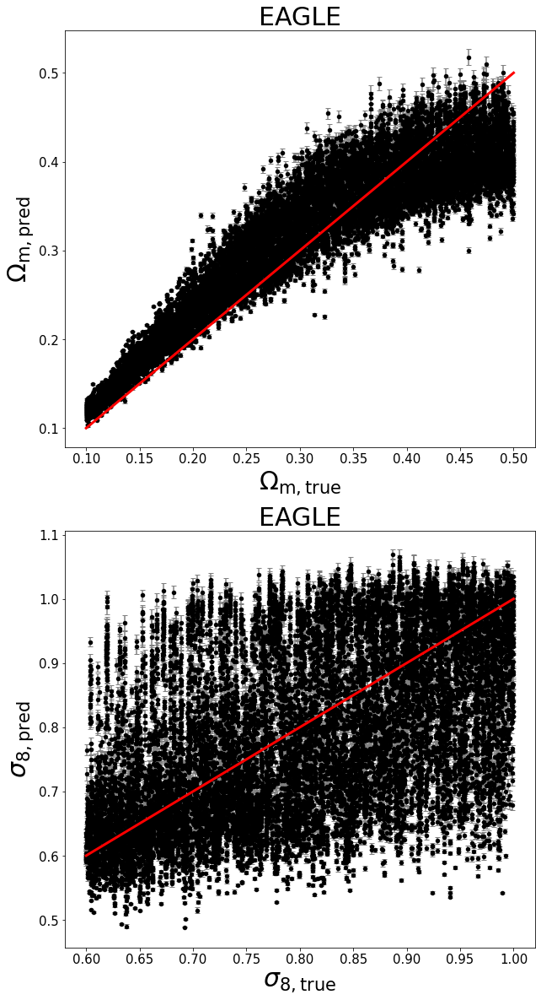

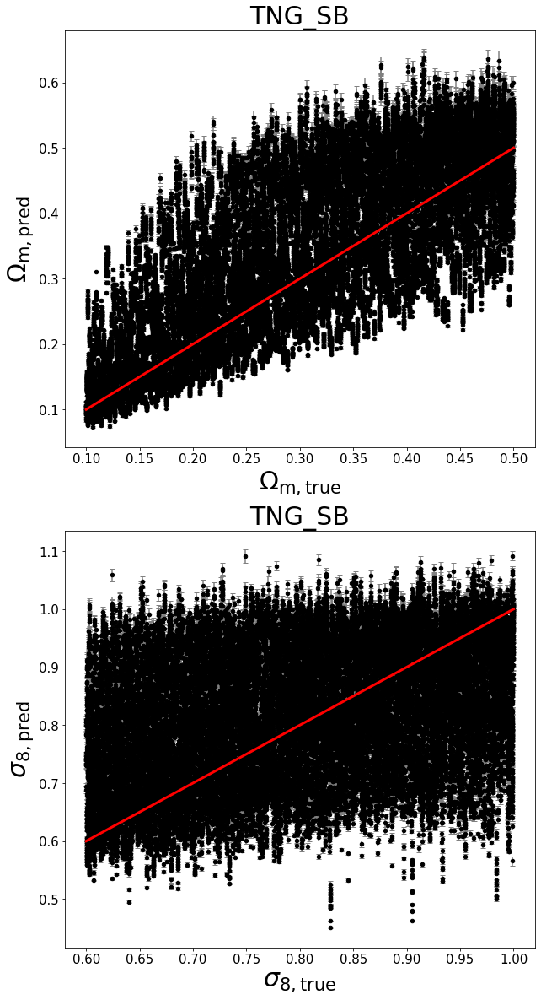

In [14]:
sim  = ['SIMBA']; field = 'HI'
study_name = 'SIMBA_HI_cnn_zero_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib_cnn",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('SIMBA', show_score=True)
mist.test_on_cnn('ASTRID', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

In [ ]:
sim  = ['SIMBA', 'TNG_SB']; field = 'HI'
study_name = 'SIMBA_TNG_SB_HI_cnn_zero_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.001, % error=9.209%, R2 score=0.922,chi2=0.781, bias=-0.016
$\sigma_8$: MSE=0.007, % error=8.752%, R2 score=0.447,chi2=2.210, bias=-0.000
(15000, 1, 256, 256) (15000, 2)


$\Omega_m$: MSE=0.002, % error=11.284%, R2 score=0.871,chi2=1.041, bias=-0.008
$\sigma_8$: MSE=0.007, % error=8.638%, R2 score=0.451,chi2=1.472, bias=0.007
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.006, % error=27.088%, R2 score=0.556,chi2=3.582, bias=-0.064
$\sigma_8$: MSE=0.009, % error=8.950%, R2 score=0.348,chi2=1.806, bias=0.045
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.002, % error=10.669%, R2 score=0.886,chi2=0.929, bias=0.001
$\sigma_8$: MSE=0.011, % error=10.630%, R2 score=0.158,chi2=2.264, bias=0.024
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.001, % error=9.617%, R2 score=0.929,chi2=0.599, bias=-0.013
$\sigma_8$: MSE=0.005, % error=7.555%, R2 score=0.604,chi2=1.043, bias=0.005


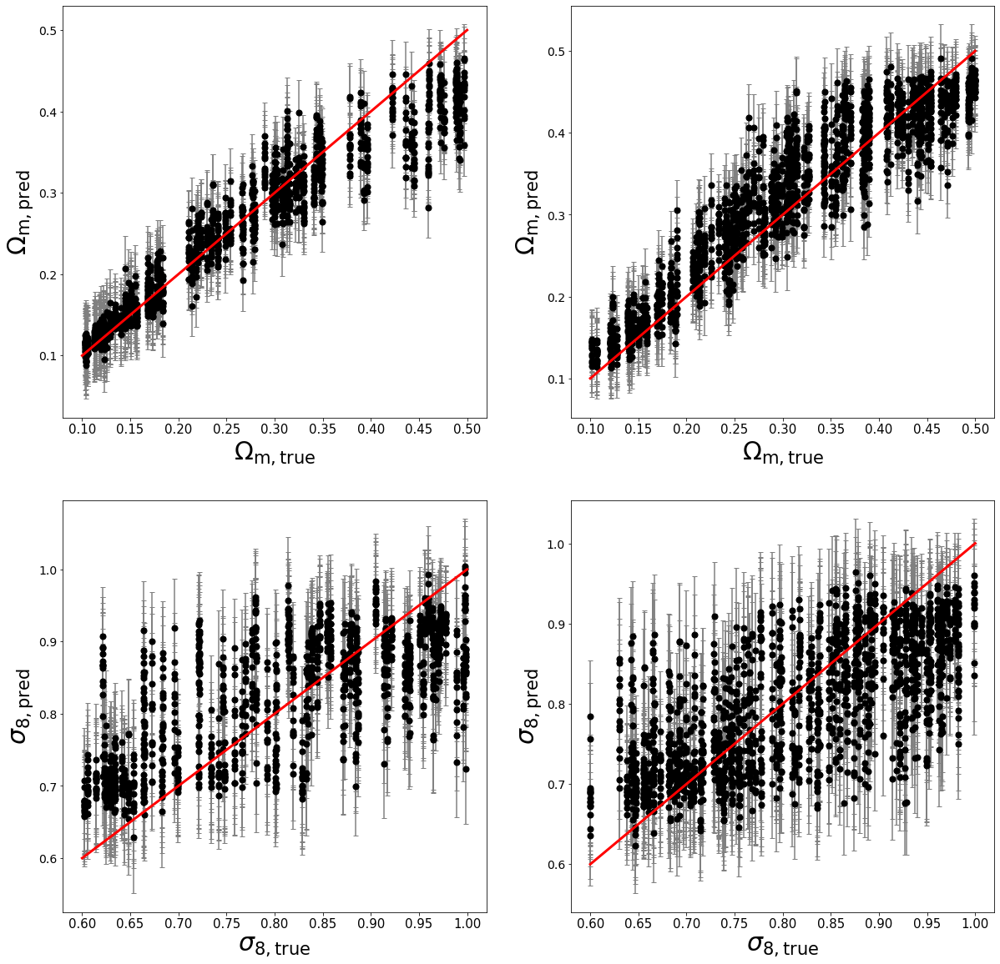

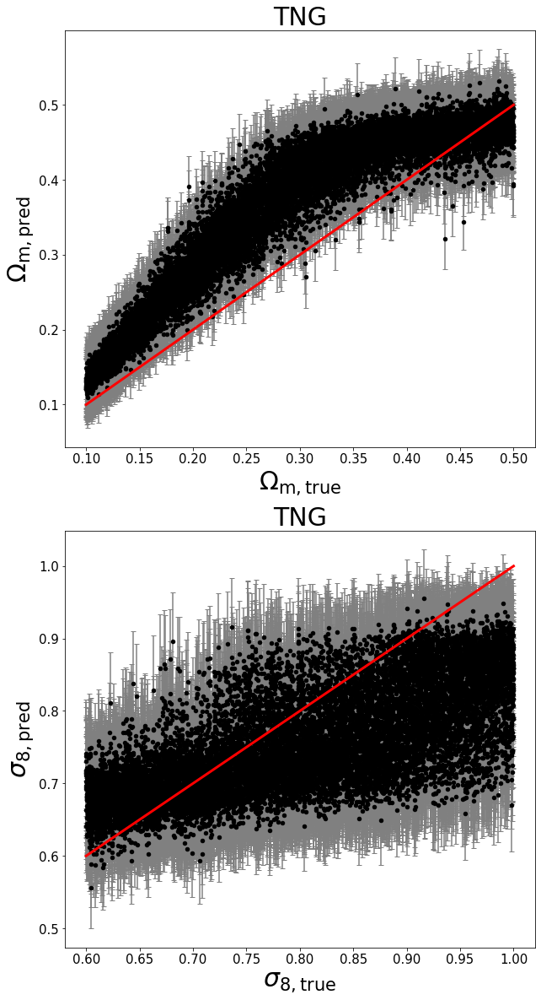

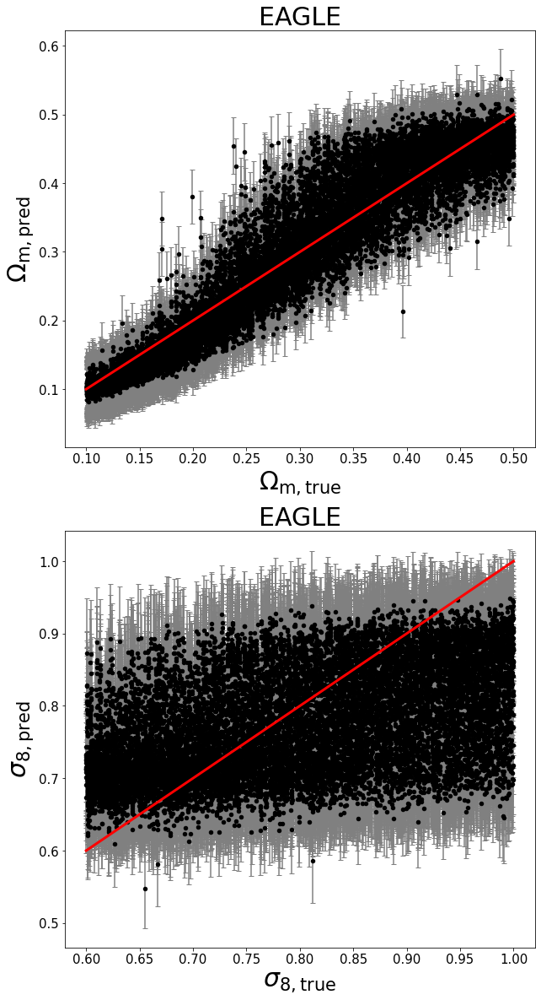

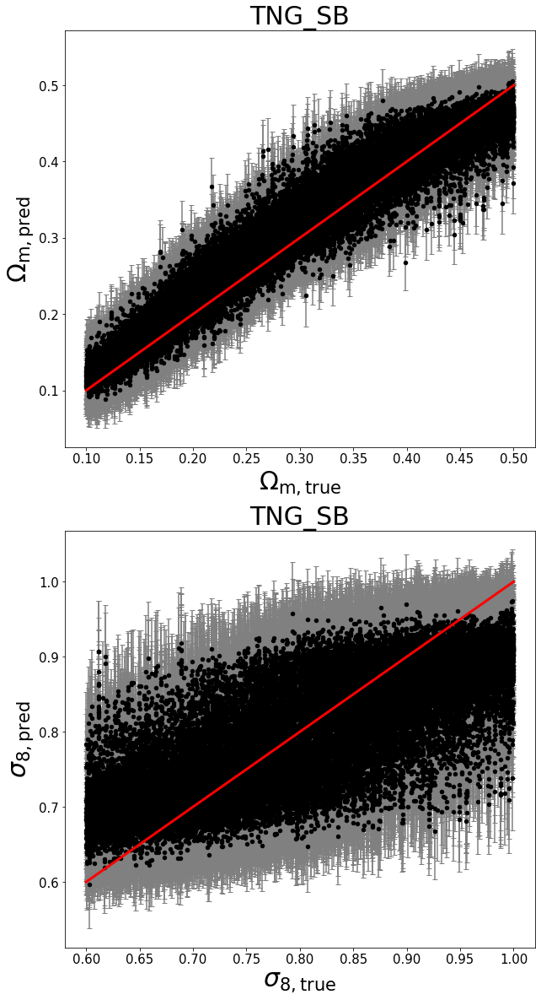

In [27]:
sim  = ['SIMBA', 'TNG_SB']; field = 'HI'
study_name = 'SIMBA_TNG_SB_HI_cnn_mid_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=4.150%, R2 score=0.978,chi2=0.407, bias=0.001
$\sigma_8$: MSE=0.002, % error=4.518%, R2 score=0.850,chi2=0.805, bias=-0.000
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.002, % error=13.096%, R2 score=0.859,chi2=2.613, bias=-0.028
$\sigma_8$: MSE=0.015, % error=13.460%, R2 score=-0.105,chi2=5.770, bias=-0.077
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.006, % error=16.392%, R2 score=0.561,chi2=9.211, bias=0.056
$\sigma_8$: MSE=0.008, % error=9.005%, R2 score=0.410,chi2=3.223, bias=-0.019
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.007, % error=23.701%, R2 score=0.481,chi2=10.268, bias=0.006
$\sigma_8$: MSE=0.013, % error=11.506%, R2 score=0.040,chi2=5.170, bias=-0.013


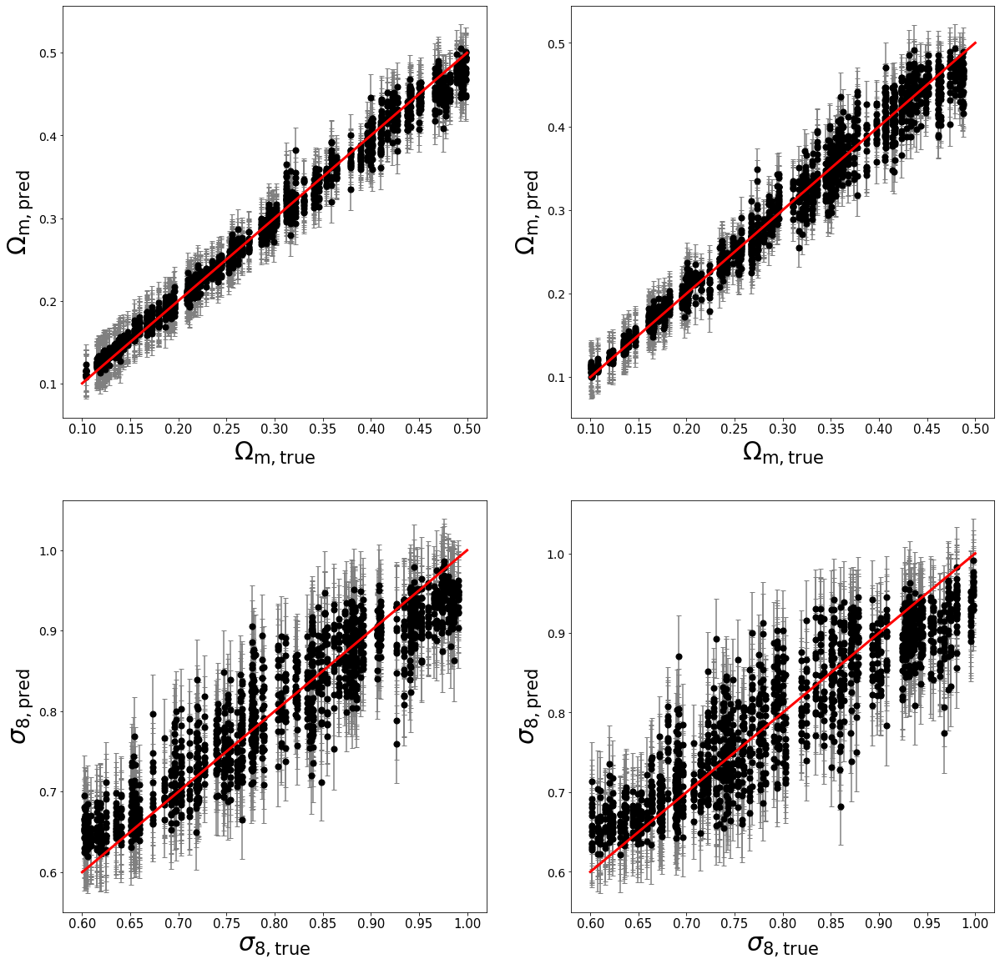

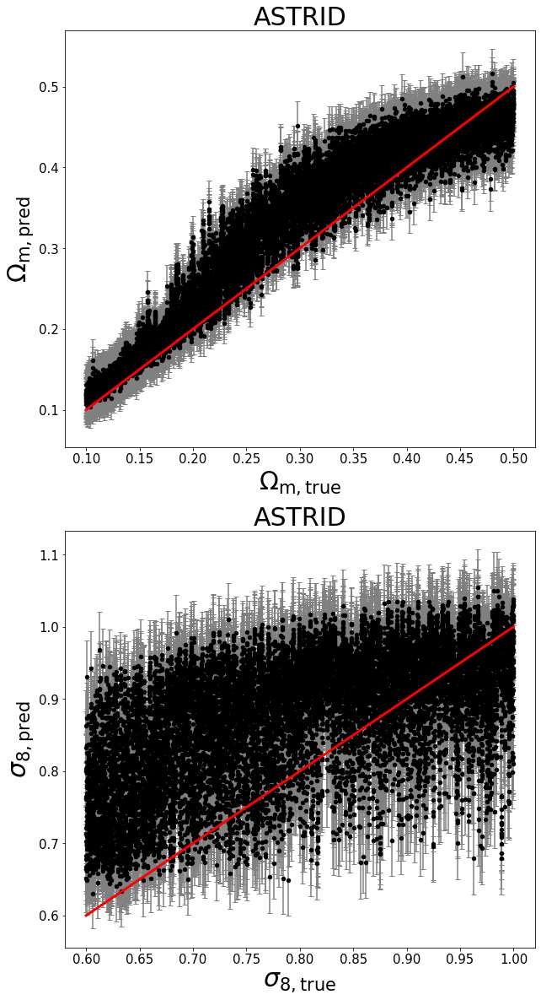

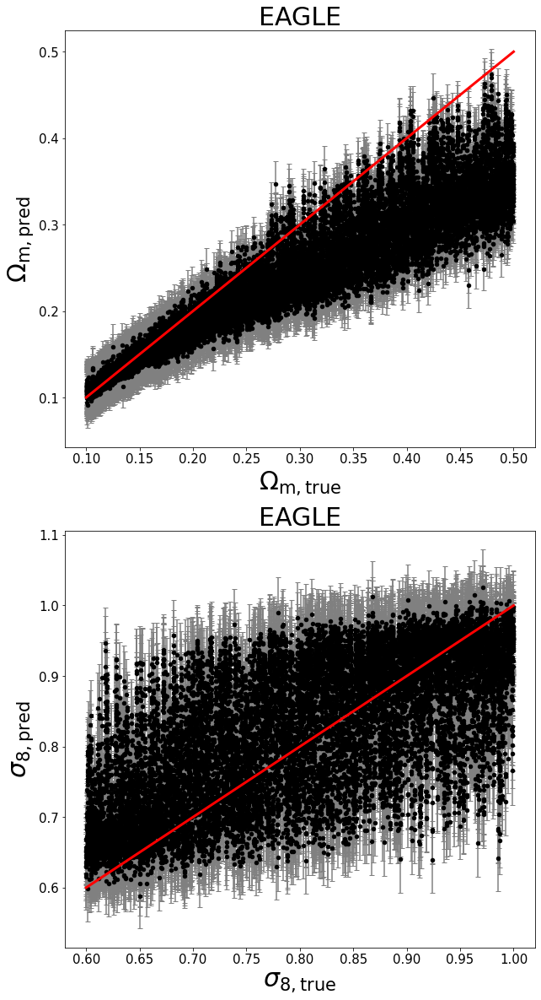

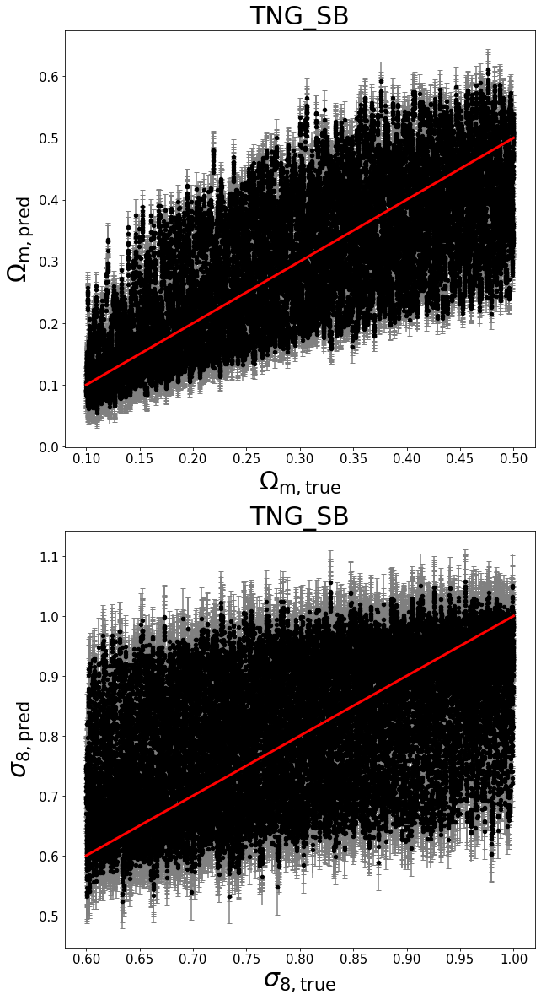

In [7]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = 'TNG_SIMBA_HI_cnn_enc_dec_low_monopole_1'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('ASTRID', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.001, % error=9.407%, R2 score=0.927,chi2=1.377, bias=-0.004
$\sigma_8$: MSE=0.005, % error=7.562%, R2 score=0.607,chi2=1.286, bias=0.001
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.007, % error=19.669%, R2 score=0.459,chi2=20.003, bias=0.051
$\sigma_8$: MSE=0.012, % error=10.765%, R2 score=0.089,chi2=3.343, bias=0.012
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.008, % error=23.677%, R2 score=0.426,chi2=15.501, bias=0.019
$\sigma_8$: MSE=0.012, % error=11.297%, R2 score=0.123,chi2=2.714, bias=-0.019


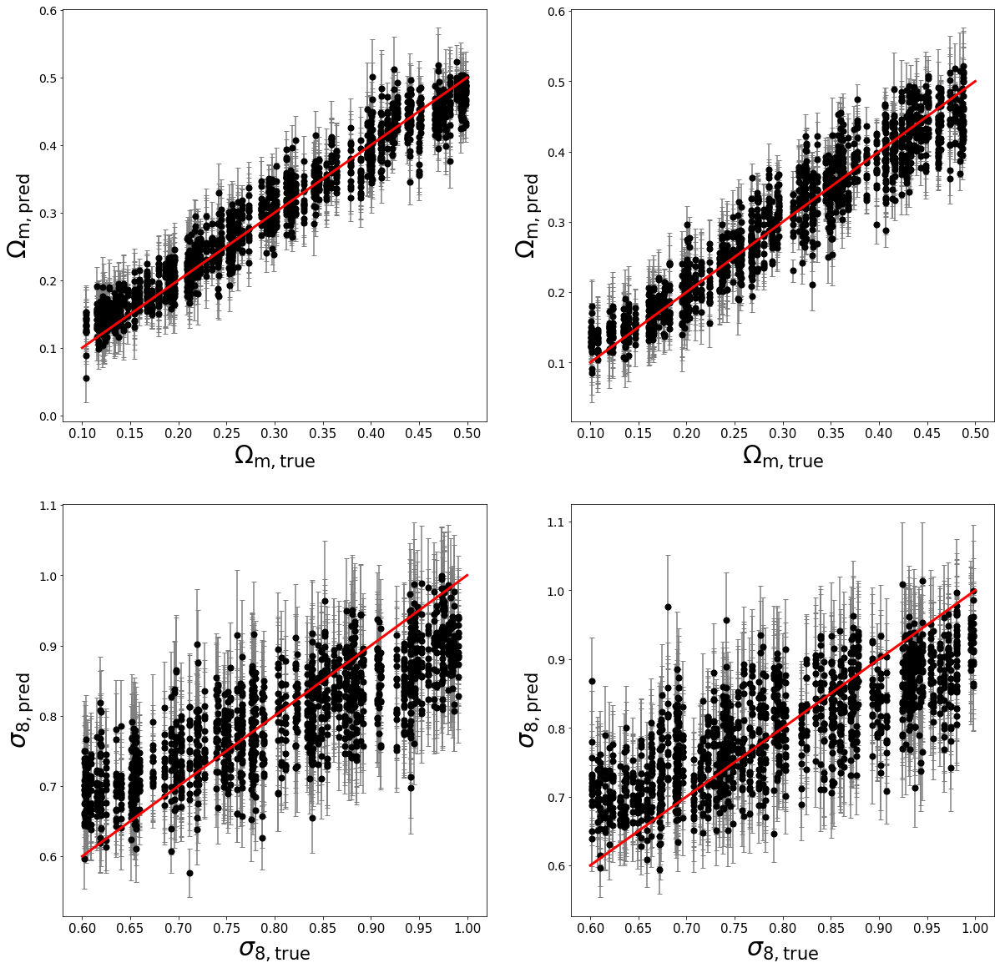

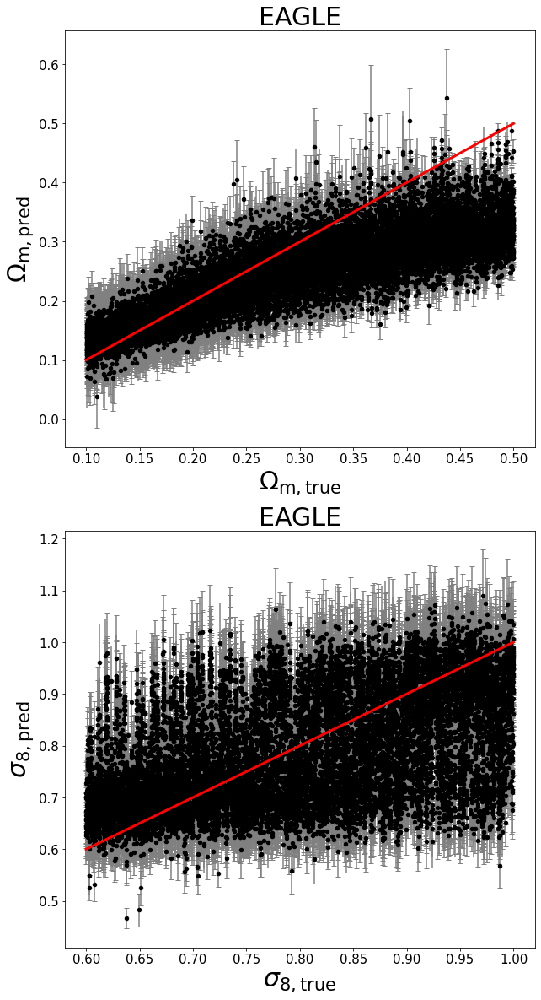

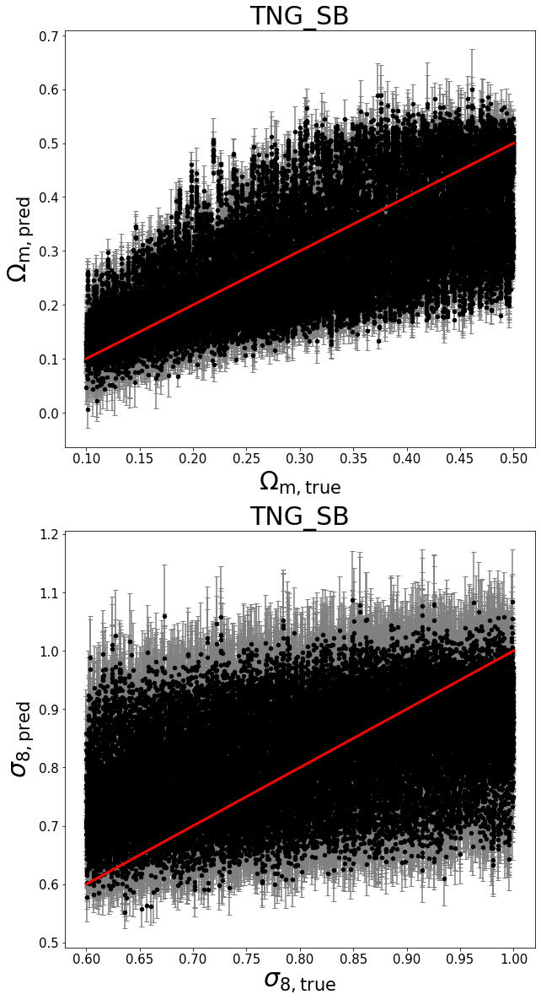

In [3]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = 'TNG_SIMBA_HI_cnn_enc_dec_high_monopole_1'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=5.093%, R2 score=0.970,chi2=0.785, bias=0.001
$\sigma_8$: MSE=0.003, % error=5.485%, R2 score=0.781,chi2=0.904, bias=0.001
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.001, % error=10.748%, R2 score=0.908,chi2=2.513, bias=-0.018
$\sigma_8$: MSE=0.017, % error=14.415%, R2 score=-0.283,chi2=5.216, bias=-0.096
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.007, % error=18.600%, R2 score=0.458,chi2=16.961, bias=0.061
$\sigma_8$: MSE=0.011, % error=10.193%, R2 score=0.150,chi2=3.774, bias=0.023
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.008, % error=23.662%, R2 score=0.401,chi2=20.594, bias=0.025
$\sigma_8$: MSE=0.014, % error=12.077%, R2 score=-0.049,chi2=4.378, bias=-0.021


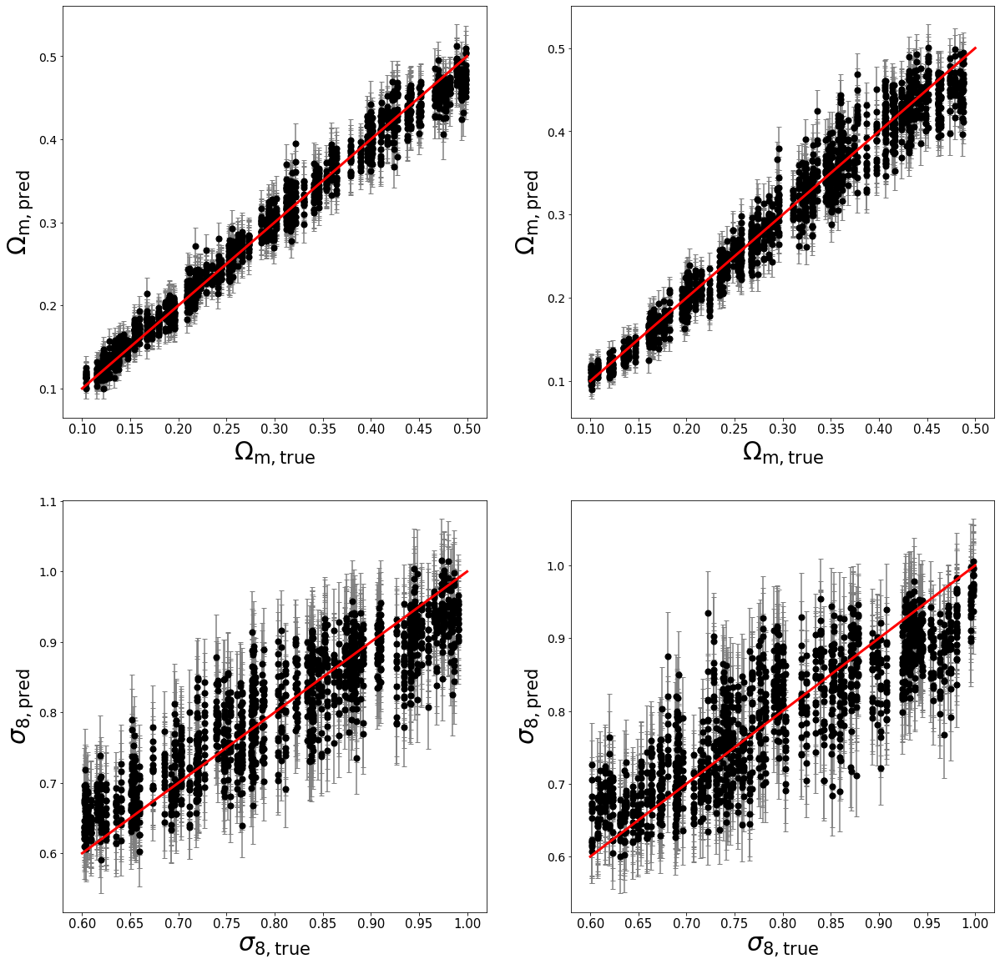

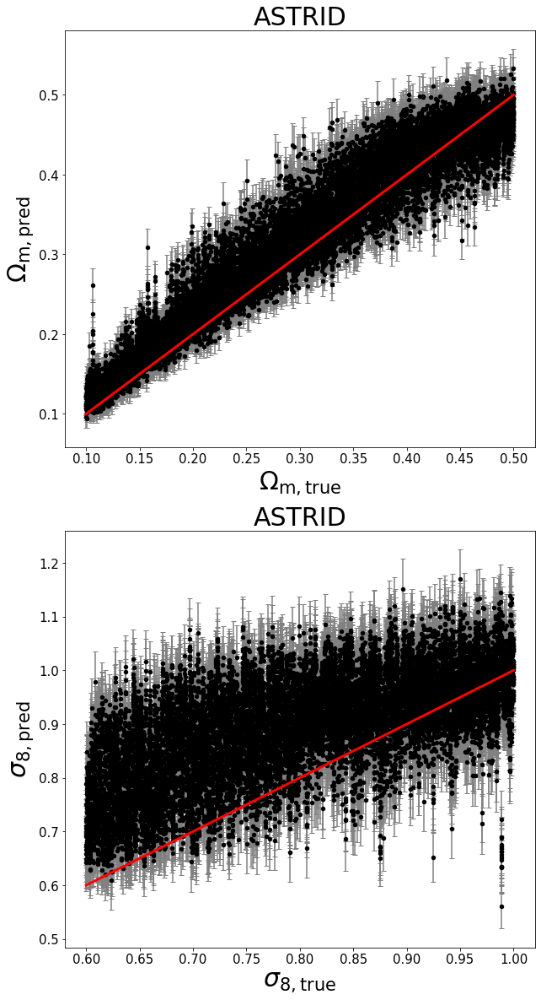

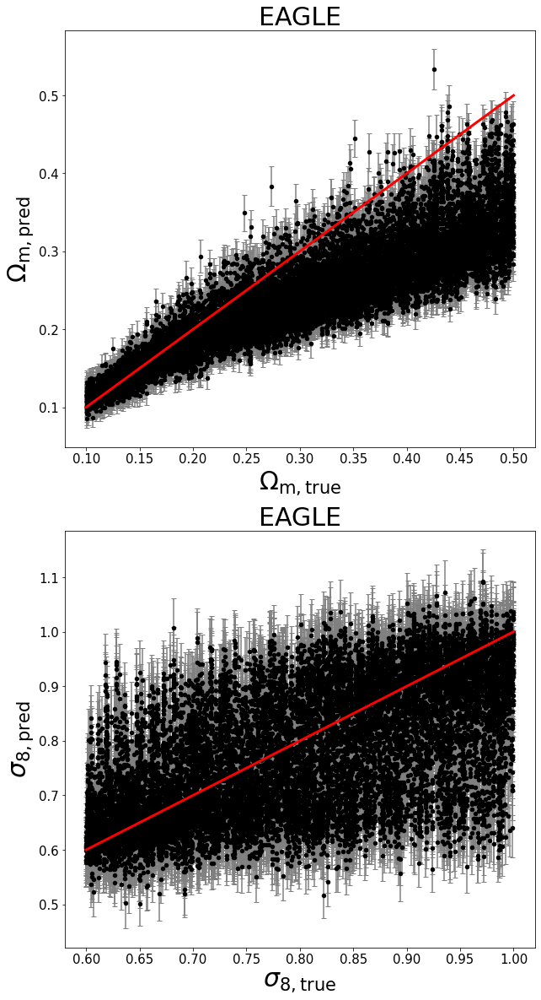

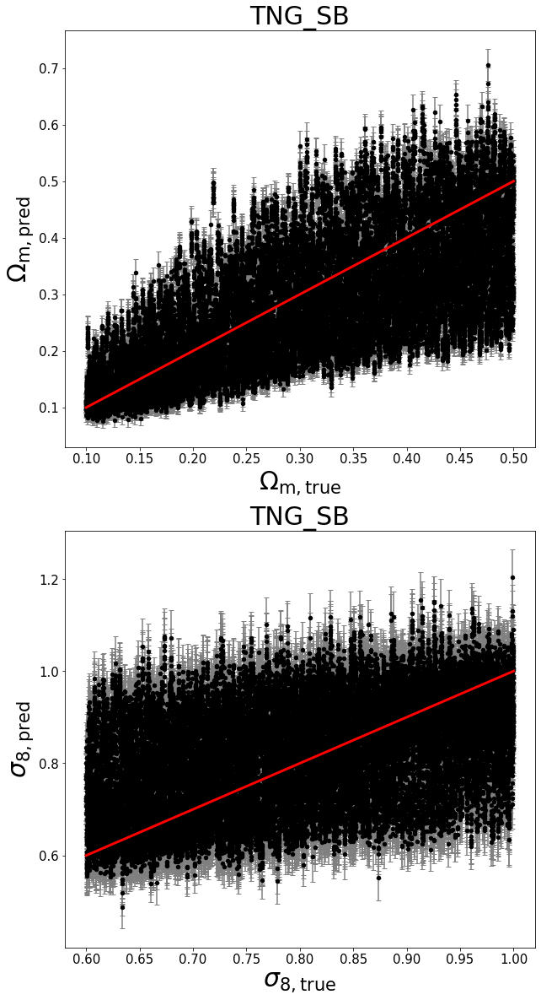

In [9]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = 'TNG_SIMBA_HI_cnn_enc_dec_mid_monopole_1'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=4.749%, R2 score=0.977,chi2=0.317, bias=-0.002
$\sigma_8$: MSE=0.002, % error=4.534%, R2 score=0.853,chi2=0.704, bias=-0.000
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.007, % error=18.418%, R2 score=0.458,chi2=8.294, bias=0.063
$\sigma_8$: MSE=0.013, % error=12.678%, R2 score=0.011,chi2=4.859, bias=-0.081
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.006, % error=23.395%, R2 score=0.514,chi2=7.067, bias=-0.003
$\sigma_8$: MSE=0.013, % error=11.335%, R2 score=0.062,chi2=4.557, bias=-0.007


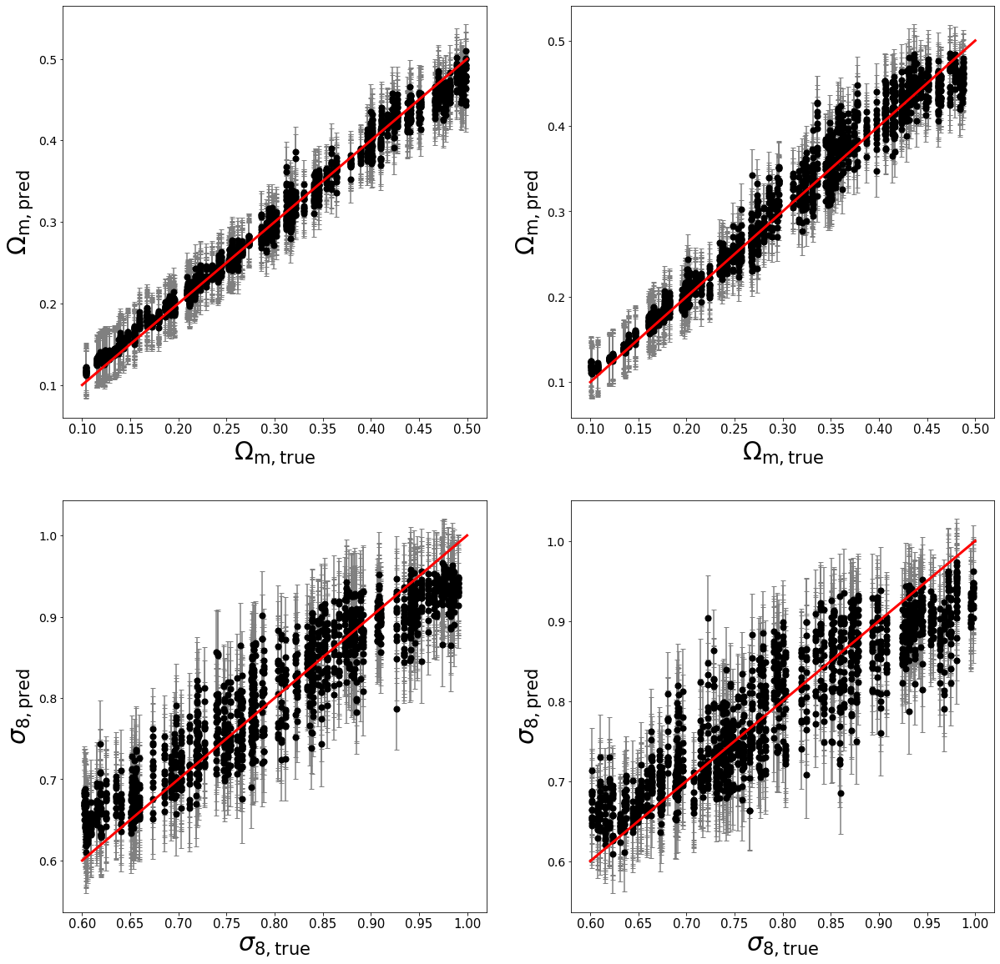

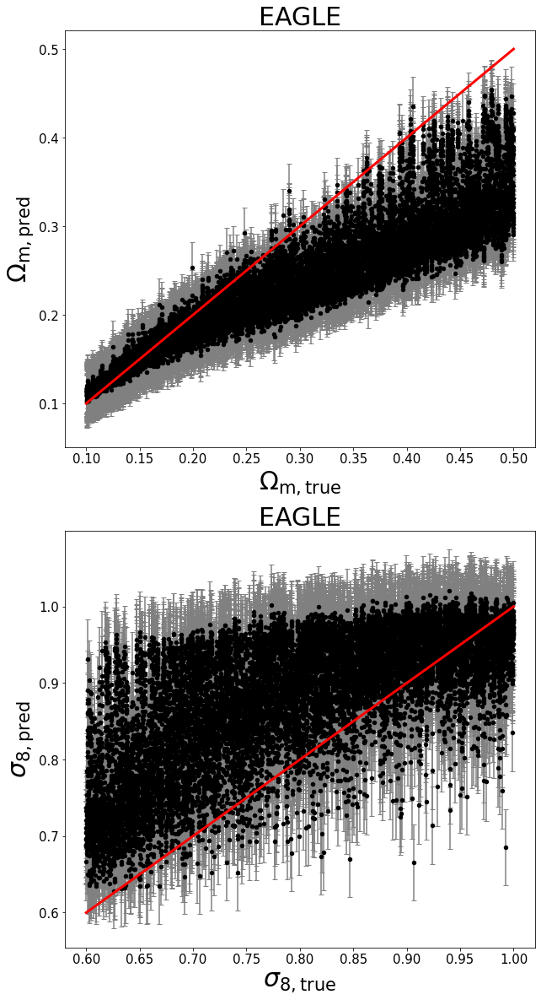

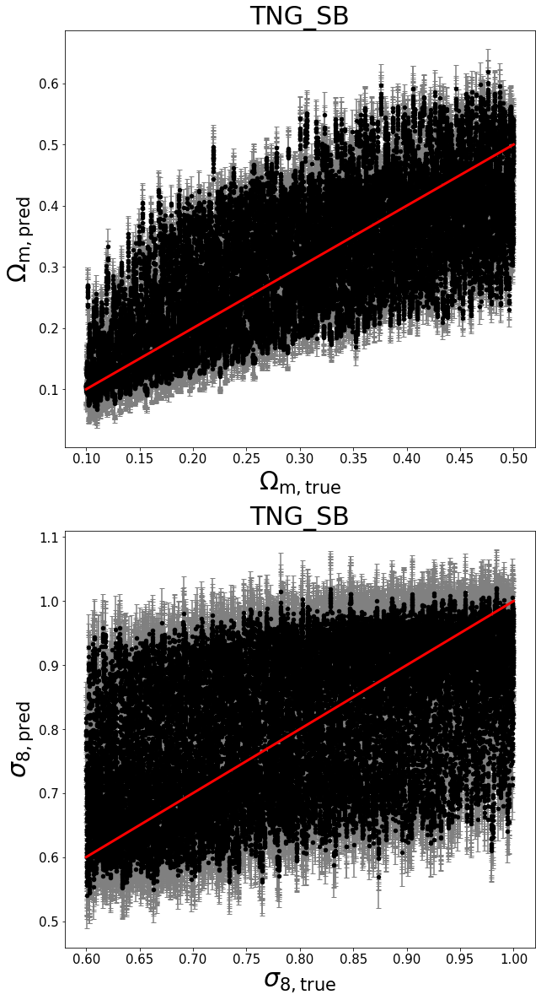

In [12]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = 'TNG_SIMBA_HI_cnn_enc_dec_zero_monopole_1'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=3.627%, R2 score=0.984,chi2=0.536, bias=0.000
$\sigma_8$: MSE=0.002, % error=4.338%, R2 score=0.876,chi2=0.912, bias=-0.005
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.008, % error=19.801%, R2 score=0.407,chi2=23.931, bias=0.070
$\sigma_8$: MSE=0.009, % error=10.110%, R2 score=0.332,chi2=4.485, bias=-0.054
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.006, % error=21.520%, R2 score=0.544,chi2=17.148, bias=0.016
$\sigma_8$: MSE=0.016, % error=12.234%, R2 score=-0.189,chi2=9.168, bias=0.040


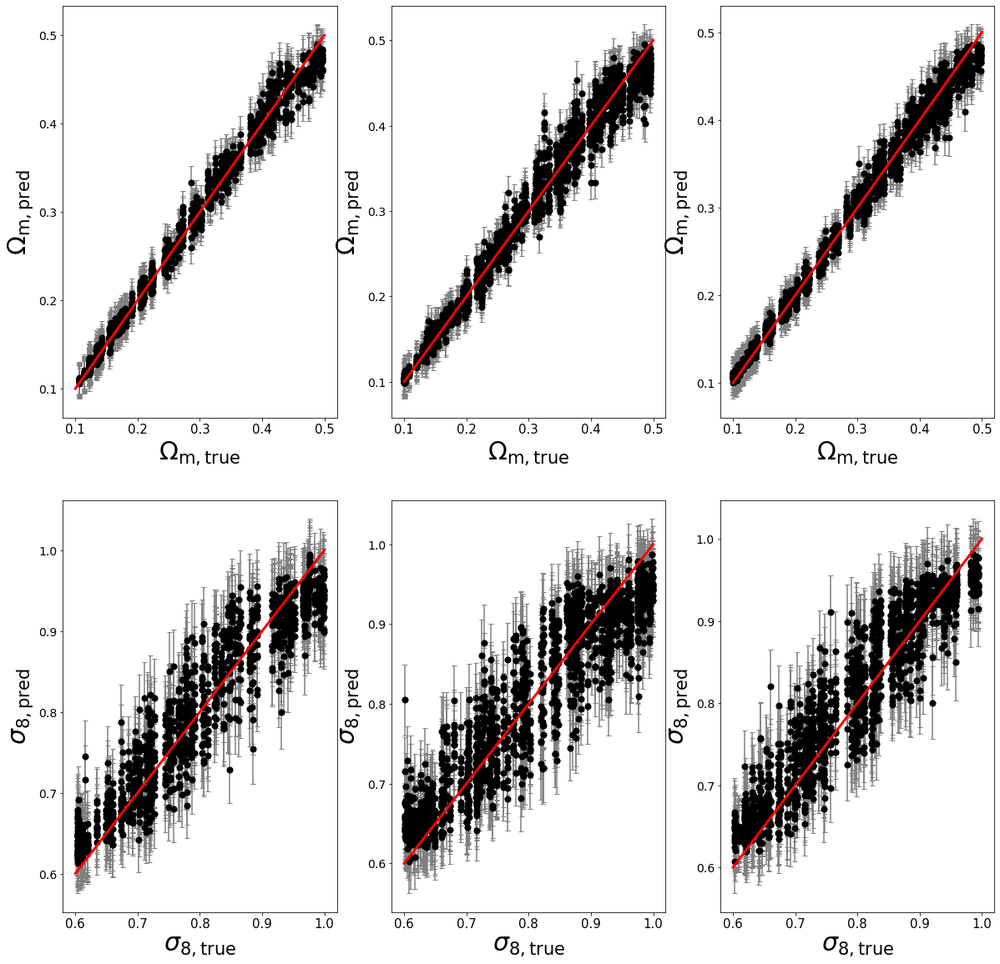

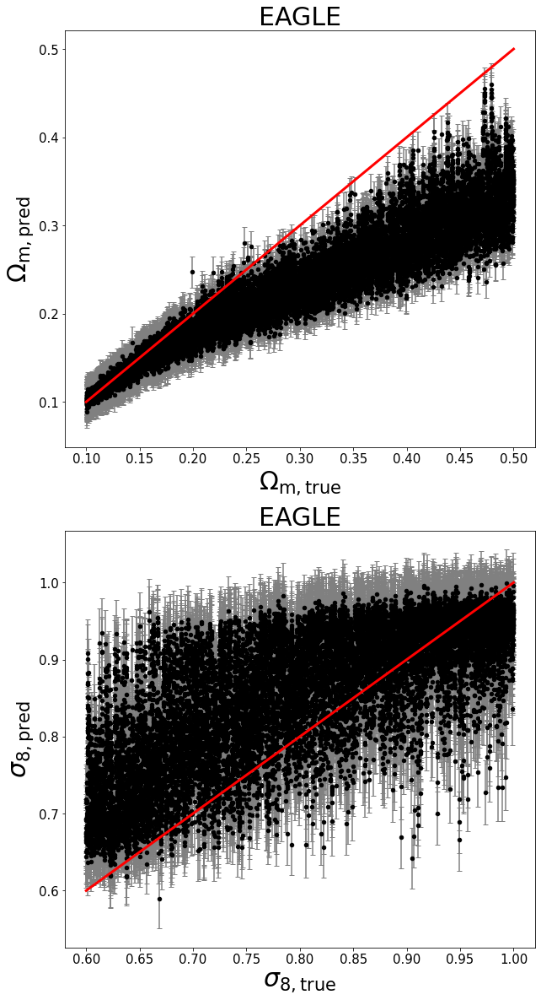

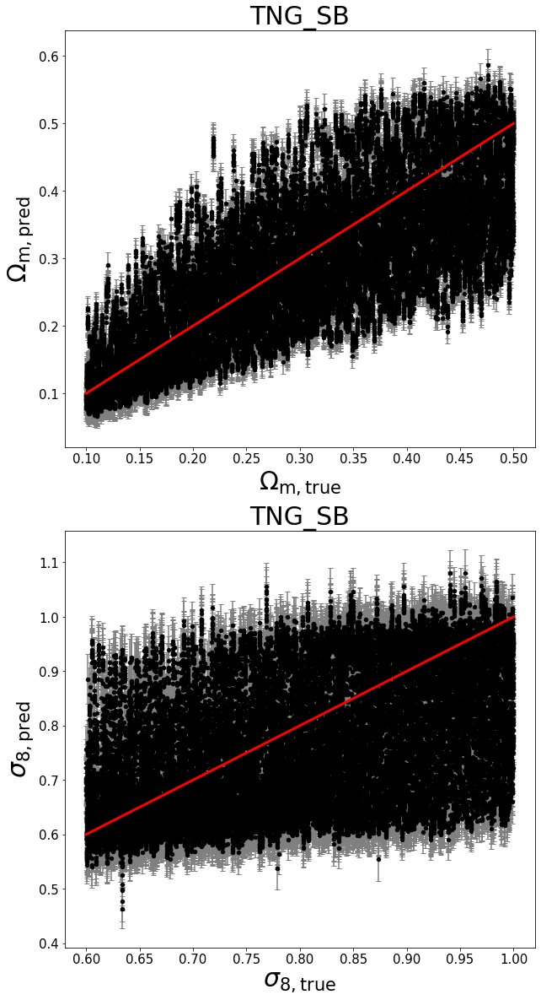

In [10]:
sim  = ['TNG', 'SIMBA', 'ASTRID']; field = 'HI'
study_name = 'TNG_SIMBA_ASTRID_HI_cnn_enc_dec_zero_monopole_1'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=3.959%, R2 score=0.981,chi2=0.755, bias=0.000
$\sigma_8$: MSE=0.002, % error=4.693%, R2 score=0.853,chi2=1.103, bias=0.002
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.009, % error=21.353%, R2 score=0.354,chi2=34.887, bias=0.074
$\sigma_8$: MSE=0.012, % error=12.055%, R2 score=0.093,chi2=6.569, bias=-0.075
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.007, % error=22.604%, R2 score=0.510,chi2=24.399, bias=0.017
$\sigma_8$: MSE=0.016, % error=12.559%, R2 score=-0.234,chi2=26.736, bias=0.044


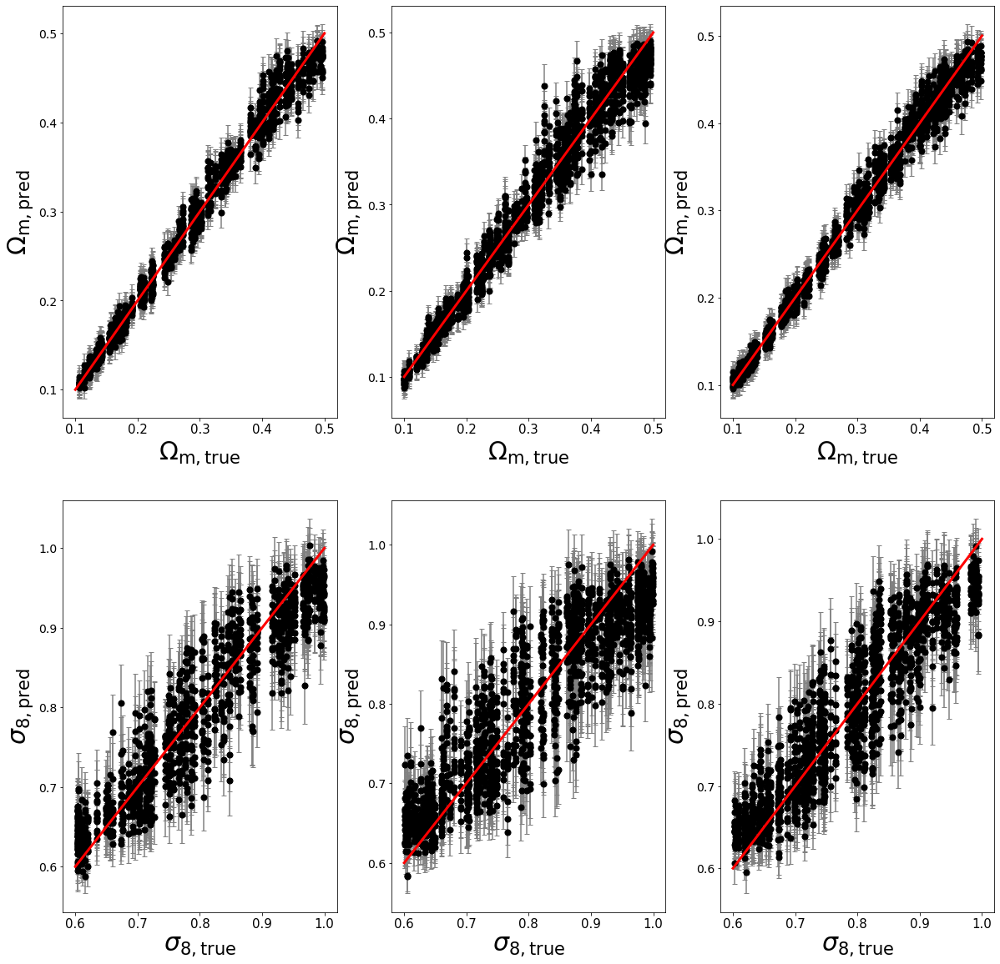

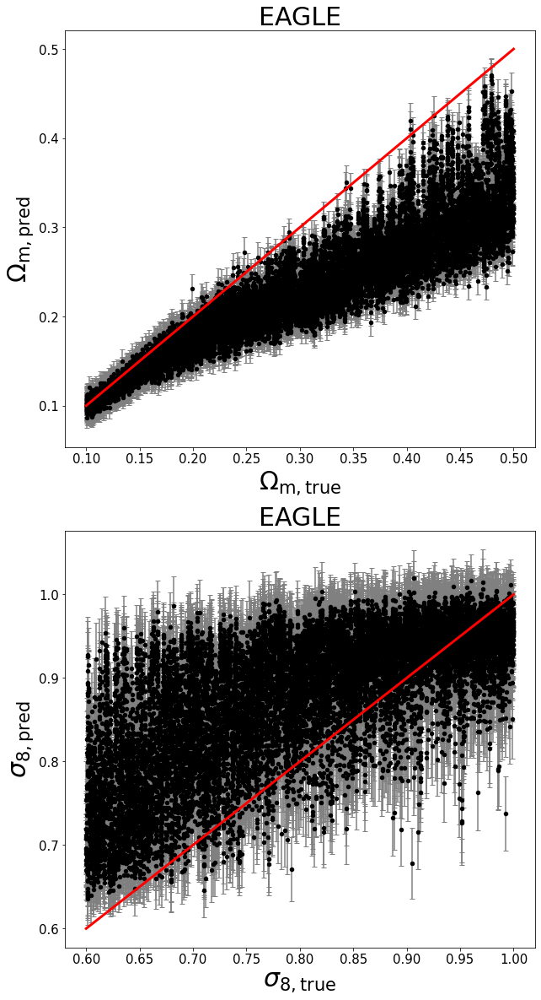

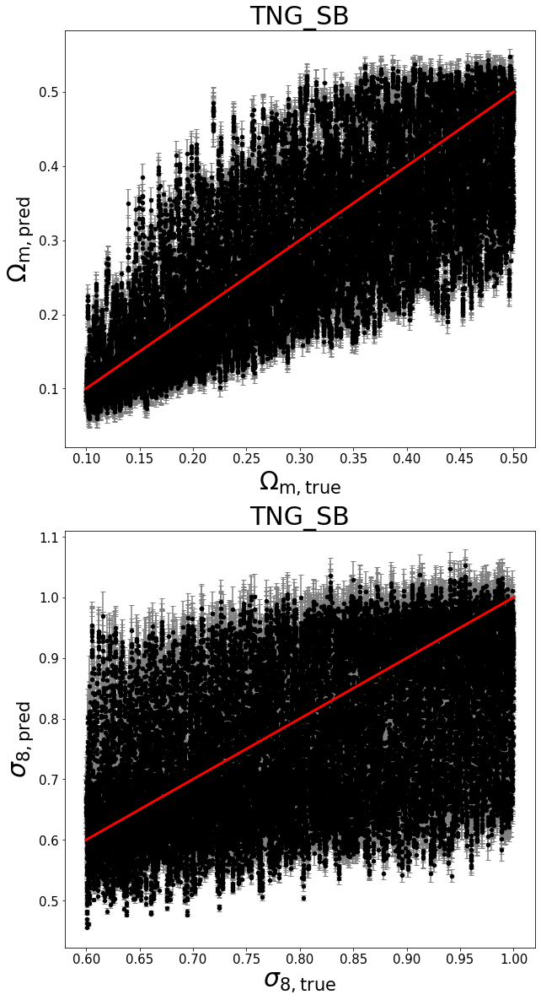

In [20]:
sim  = ['TNG', 'SIMBA', 'ASTRID']; field = 'HI'
study_name = 'TNG_SIMBA_ASTRID_HI_cnn_enc_dec_low_monopole_1'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=4.137%, R2 score=0.980,chi2=0.640, bias=0.001
$\sigma_8$: MSE=0.002, % error=4.163%, R2 score=0.877,chi2=1.286, bias=0.003
(30720, 1, 256, 256) (30720, 2)
$\Omega_m$: MSE=0.006, % error=21.683%, R2 score=0.546,chi2=15.924, bias=0.019
$\sigma_8$: MSE=0.019, % error=13.329%, R2 score=-0.424,chi2=14.579, bias=0.077


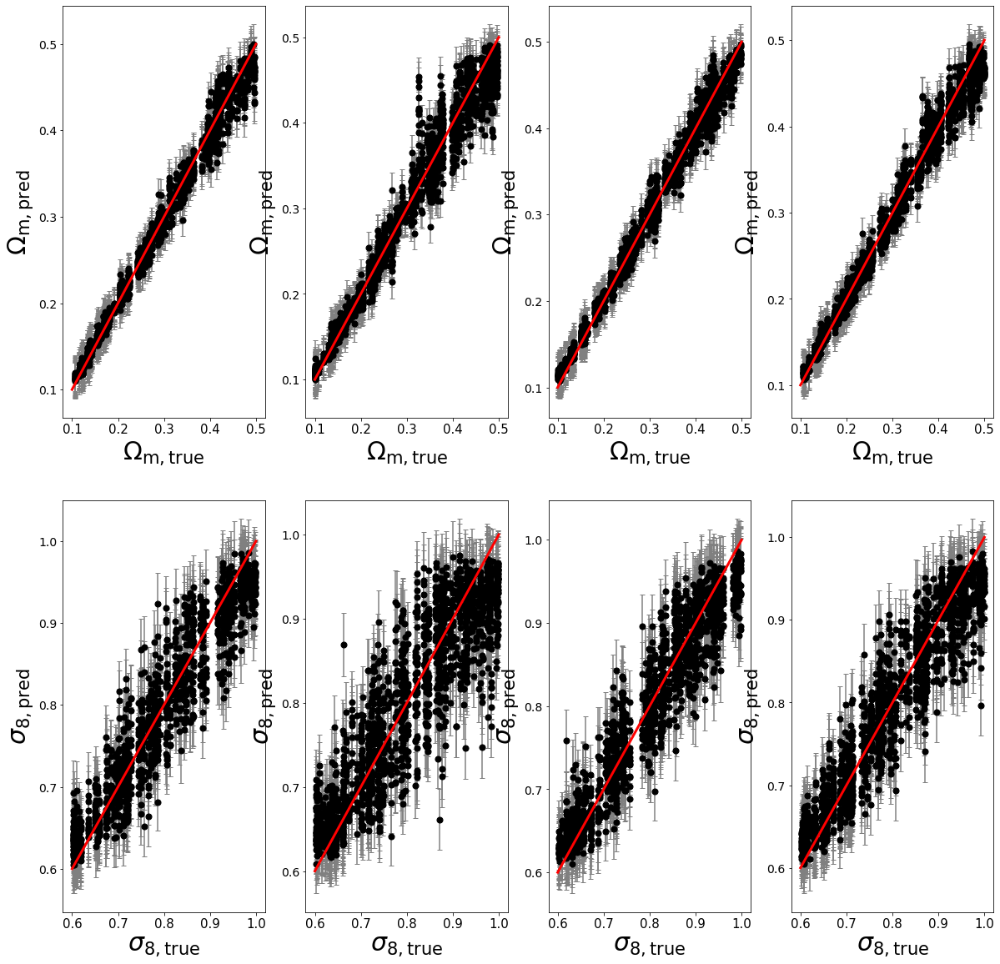

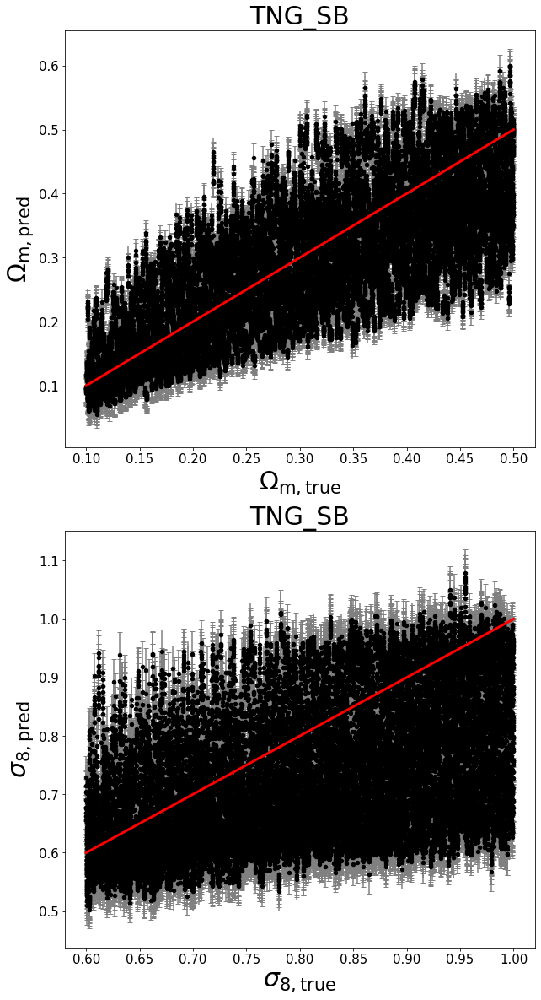

In [6]:
sim  = ['TNG', 'SIMBA', 'ASTRID', 'EAGLE']; field = 'HI'
study_name = 'TNG_SIMBA_ASTRID_EAGLE_HI_cnn_zero_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=3.627%, R2 score=0.984,chi2=0.535, bias=0.000
$\sigma_8$: MSE=0.002, % error=4.338%, R2 score=0.876,chi2=0.911, bias=-0.005
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.008, % error=19.801%, R2 score=0.407,chi2=23.927, bias=0.070
$\sigma_8$: MSE=0.009, % error=10.110%, R2 score=0.332,chi2=4.486, bias=-0.054


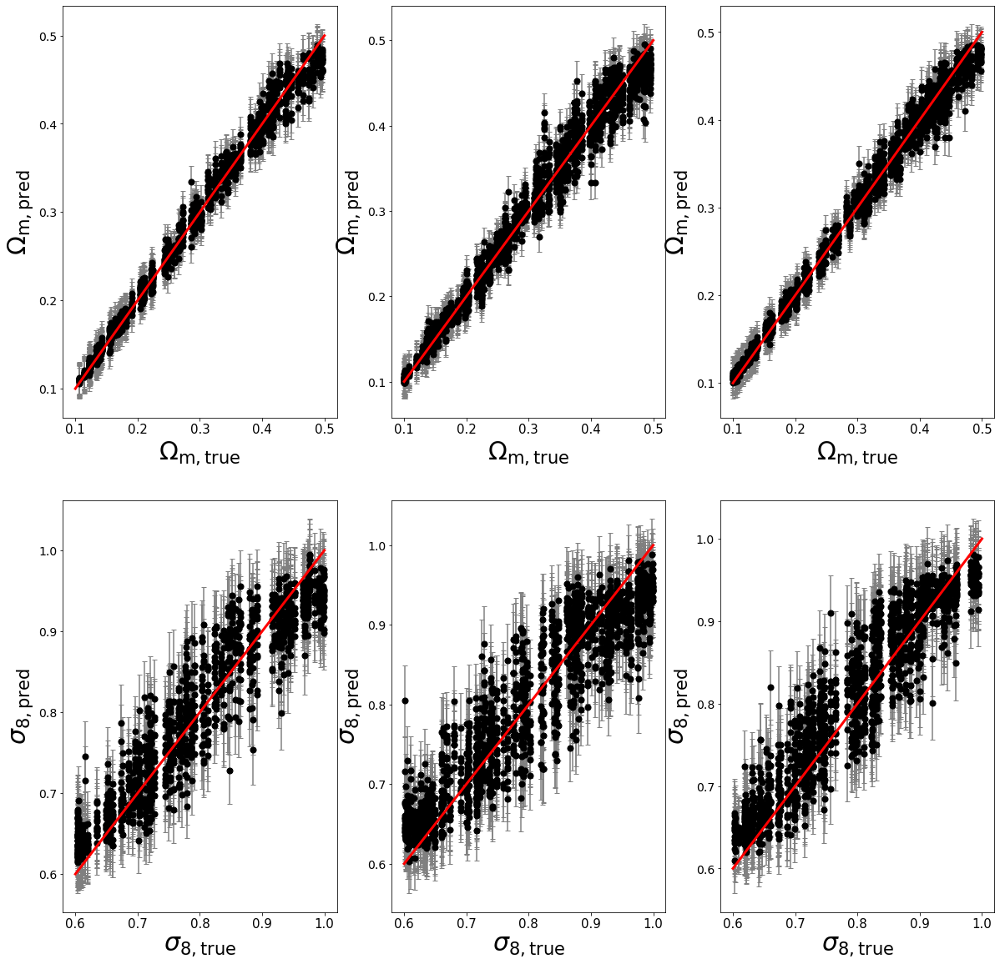

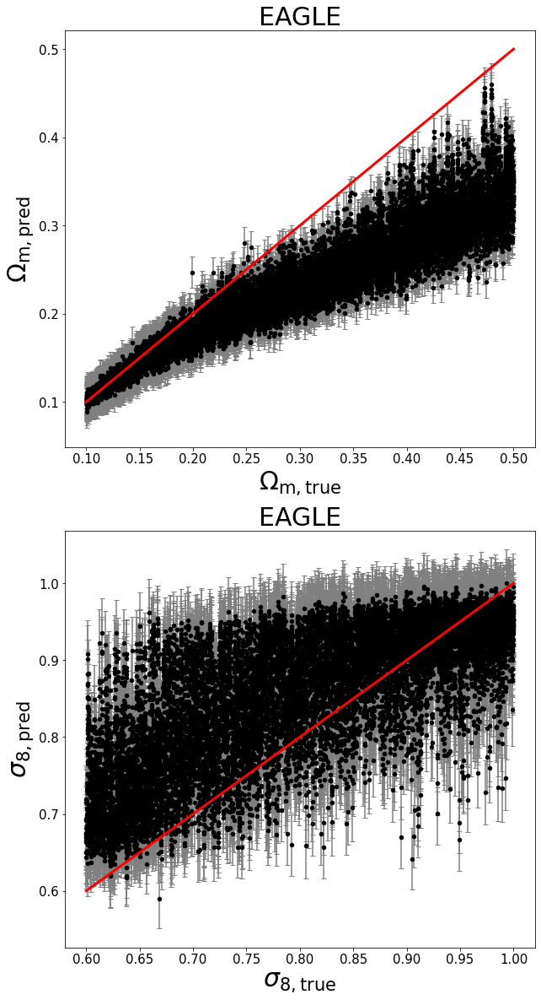

In [25]:
sim  = ['TNG', 'SIMBA', 'ASTRID']; field = 'HI'
study_name = 'TNG_SIMBA_ASTRID_HI_cnn_zero_monopole_1_new'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=3.998%, R2 score=0.981,chi2=0.760, bias=0.000
$\sigma_8$: MSE=0.002, % error=4.688%, R2 score=0.853,chi2=1.105, bias=0.002
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.009, % error=21.346%, R2 score=0.355,chi2=34.843, bias=0.074
$\sigma_8$: MSE=0.012, % error=12.061%, R2 score=0.092,chi2=6.559, bias=-0.075


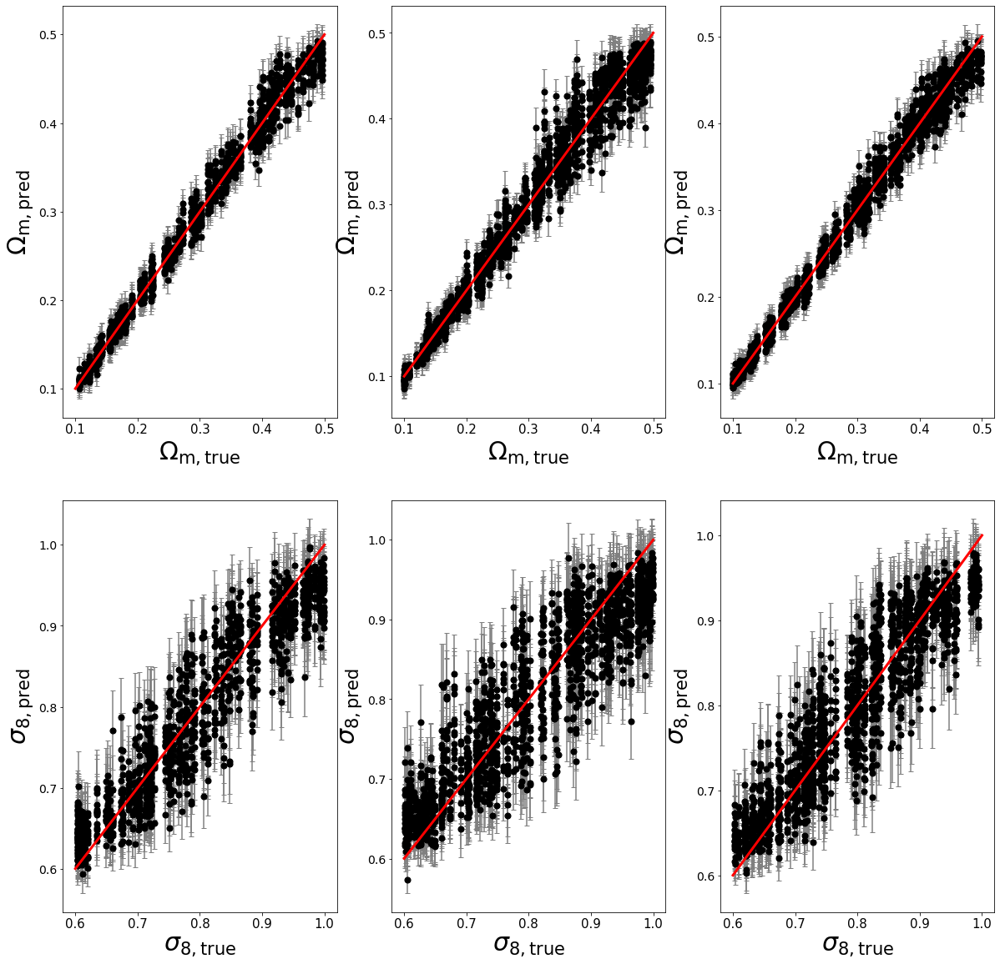

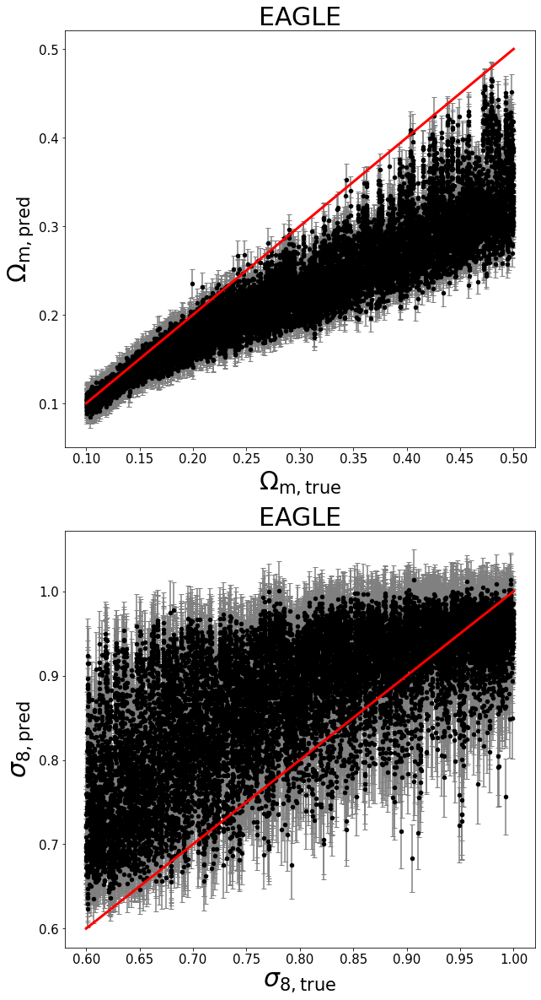

In [33]:
sim  = ['TNG', 'SIMBA', 'ASTRID']; field = 'HI'
study_name = 'TNG_SIMBA_ASTRID_HI_cnn_enc_dec_low_monopole_1'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=4.745%, R2 score=0.977,chi2=0.317, bias=-0.002
$\sigma_8$: MSE=0.002, % error=4.533%, R2 score=0.853,chi2=0.704, bias=-0.000
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.007, % error=18.414%, R2 score=0.458,chi2=8.294, bias=0.063
$\sigma_8$: MSE=0.013, % error=12.679%, R2 score=0.011,chi2=4.859, bias=-0.081
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.002, % error=13.947%, R2 score=0.847,chi2=2.136, bias=-0.023
$\sigma_8$: MSE=0.029, % error=20.316%, R2 score=-1.200,chi2=10.174, bias=-0.144


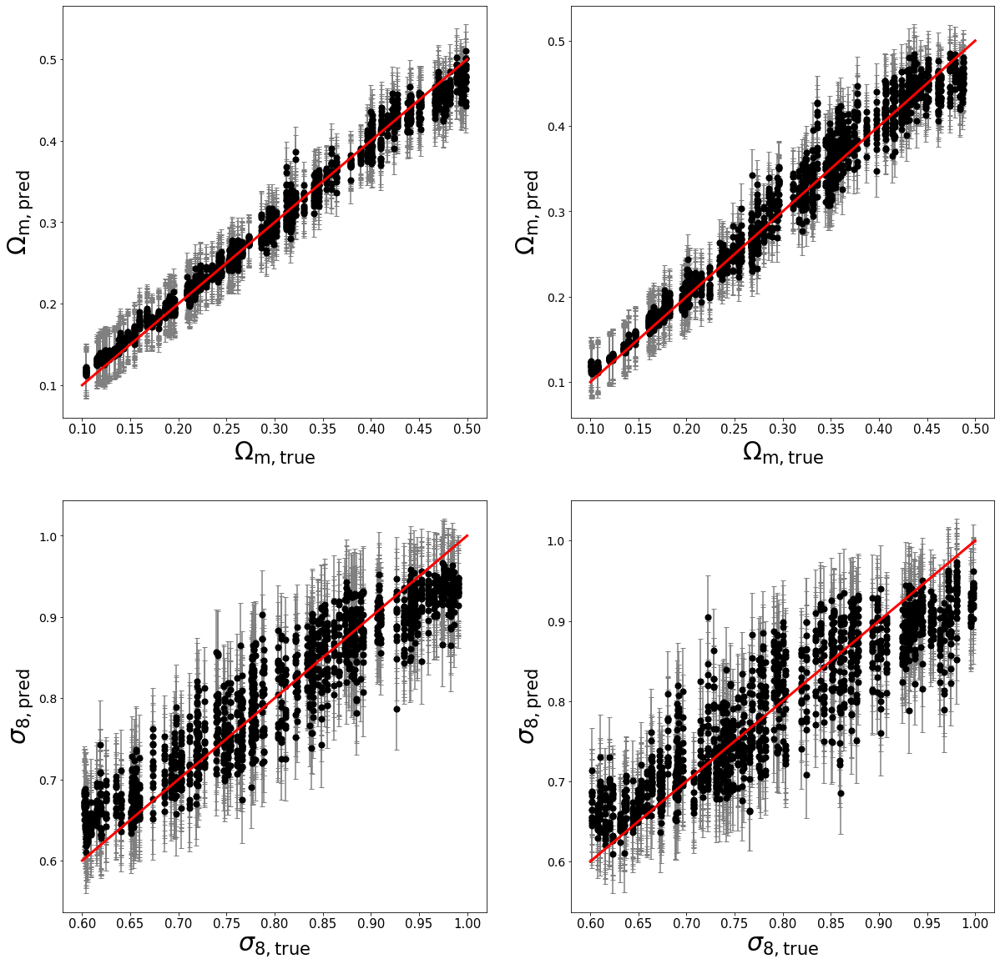

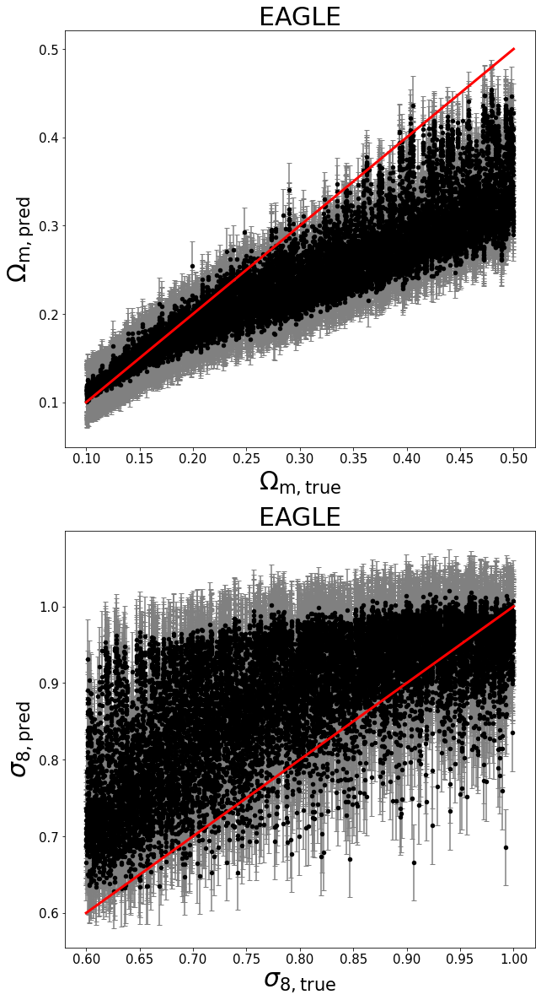

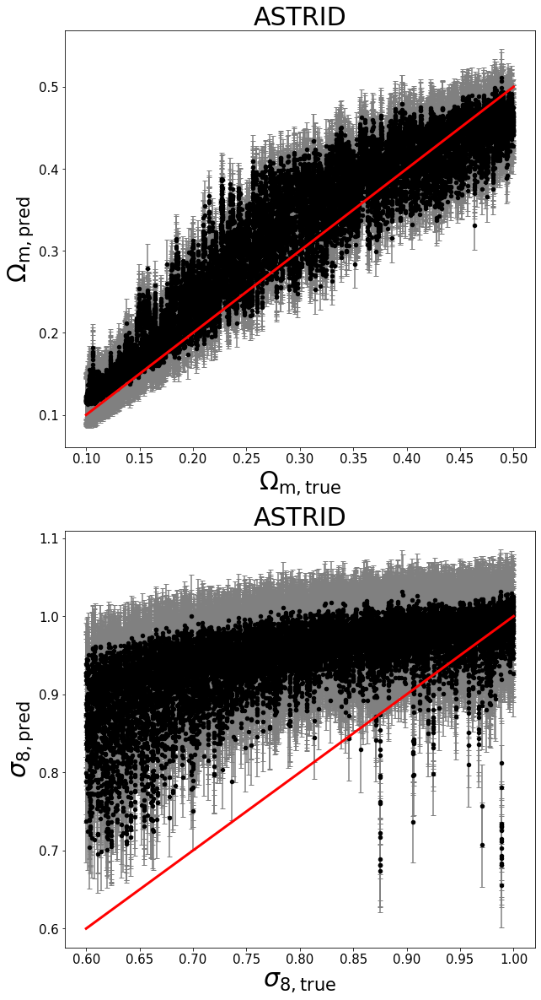

In [35]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = 'TNG_SIMBA_HI_cnn_enc_dec_zero_monopole_1'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('ASTRID', show_score=True)
import torch
torch.cuda.empty_cache()
import gc
gc.collect()
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=5.125%, R2 score=0.970,chi2=0.786, bias=0.002
$\sigma_8$: MSE=0.003, % error=5.459%, R2 score=0.782,chi2=0.896, bias=0.001
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.007, % error=18.573%, R2 score=0.458,chi2=16.940, bias=0.061
$\sigma_8$: MSE=0.011, % error=10.187%, R2 score=0.150,chi2=3.779, bias=0.023
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.001, % error=10.748%, R2 score=0.907,chi2=2.517, bias=-0.018
$\sigma_8$: MSE=0.017, % error=14.424%, R2 score=-0.285,chi2=5.218, bias=-0.096


5

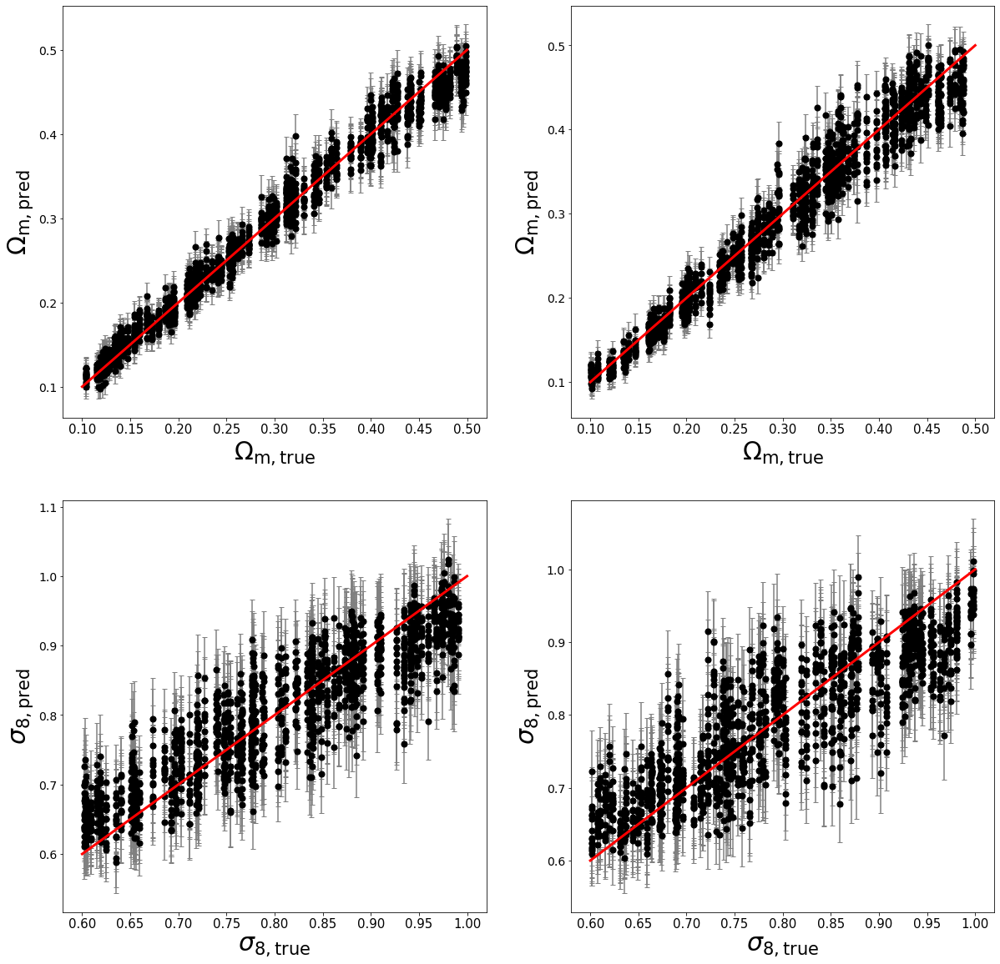

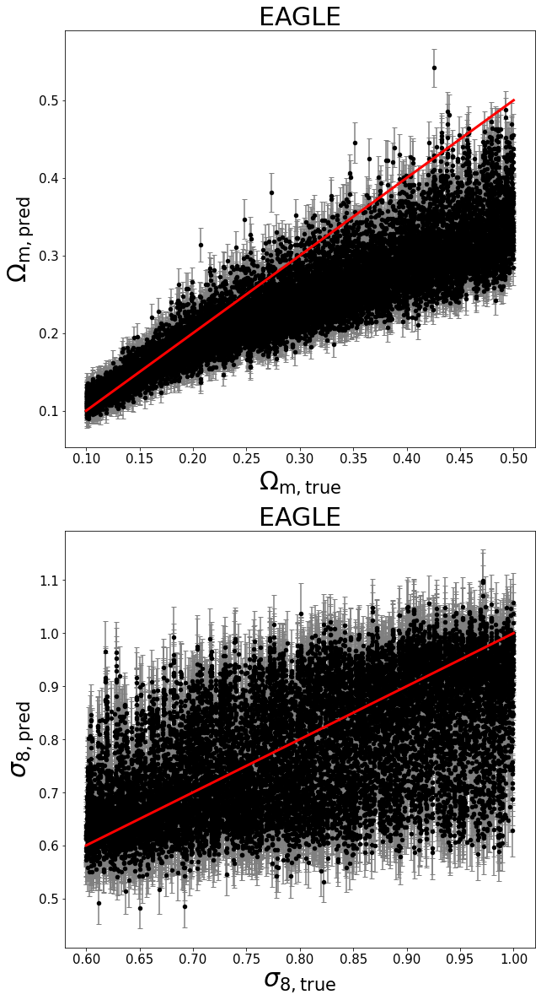

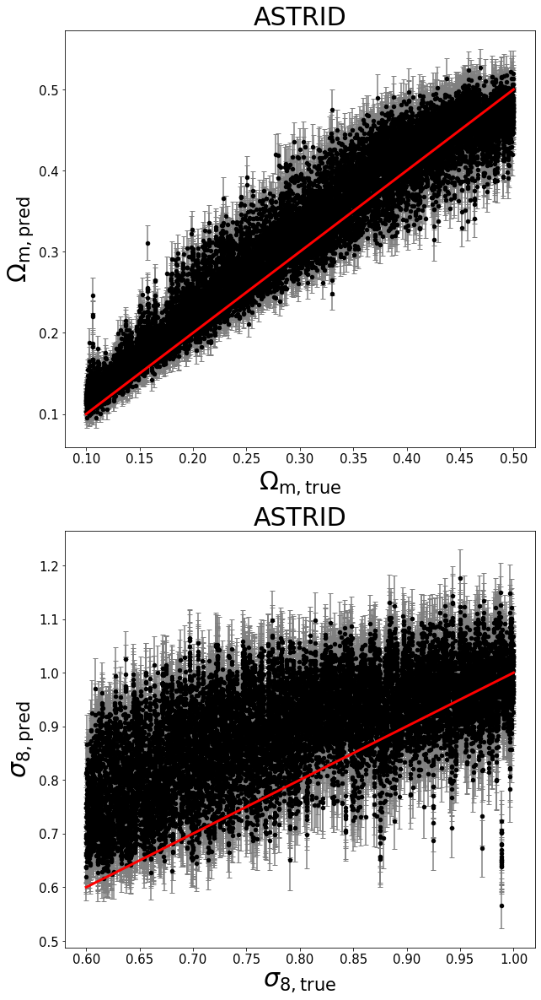

In [37]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = 'TNG_SIMBA_HI_cnn_enc_dec_mid_monopole_1'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zeromono_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('ASTRID', show_score=True)
import torch
torch.cuda.empty_cache()
import gc
gc.collect()

#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=4.219%, R2 score=0.974,chi2=0.560, bias=0.002
$\sigma_8$: MSE=0.002, % error=4.651%, R2 score=0.838,chi2=1.108, bias=-0.002
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.005, % error=15.408%, R2 score=0.647,chi2=9.788, bias=0.051
$\sigma_8$: MSE=0.016, % error=13.583%, R2 score=-0.171,chi2=7.893, bias=-0.086
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.002, % error=13.498%, R2 score=0.827,chi2=3.624, bias=-0.038
$\sigma_8$: MSE=0.023, % error=17.811%, R2 score=-0.720,chi2=11.020, bias=-0.127


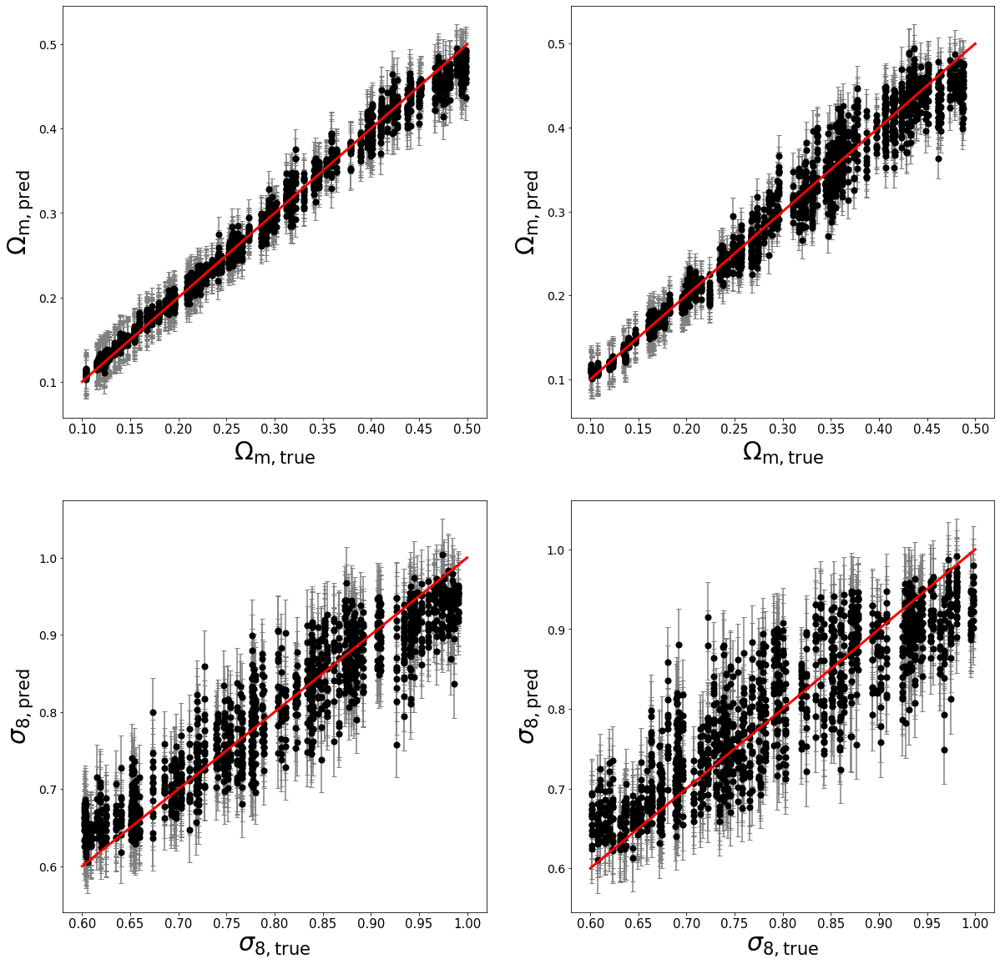

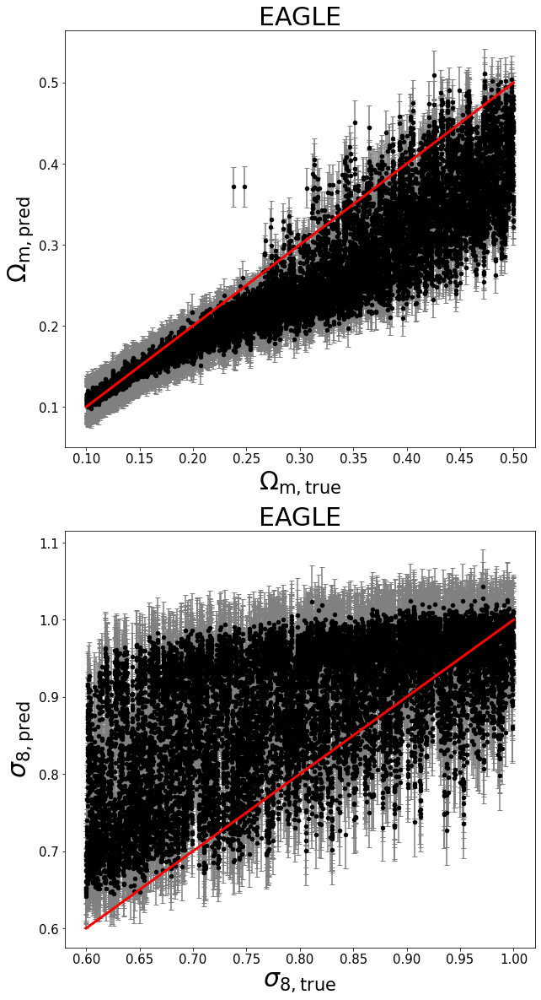

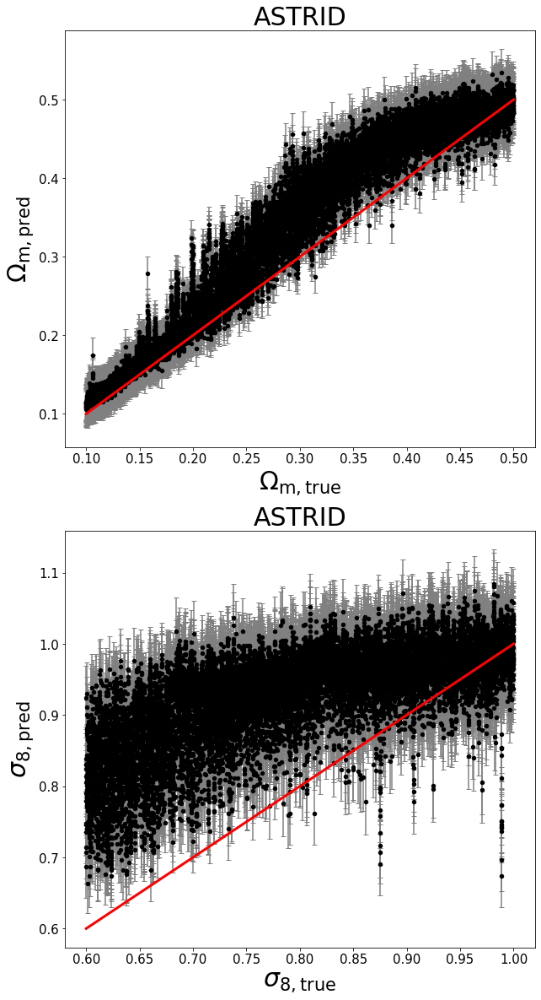

In [19]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = 'TNG_SIMBA_HI_cnn_zero_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('ASTRID', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=4.200%, R2 score=0.984,chi2=0.453, bias=-0.003
$\sigma_8$: MSE=0.001, % error=3.521%, R2 score=0.901,chi2=0.805, bias=0.005
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.007, % error=27.377%, R2 score=0.440,chi2=13.328, bias=-0.077
$\sigma_8$: MSE=0.055, % error=25.216%, R2 score=-3.098,chi2=41.255, bias=0.209
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.003, % error=12.581%, R2 score=0.755,chi2=5.413, bias=-0.020
$\sigma_8$: MSE=0.021, % error=15.367%, R2 score=-0.603,chi2=14.462, bias=0.054


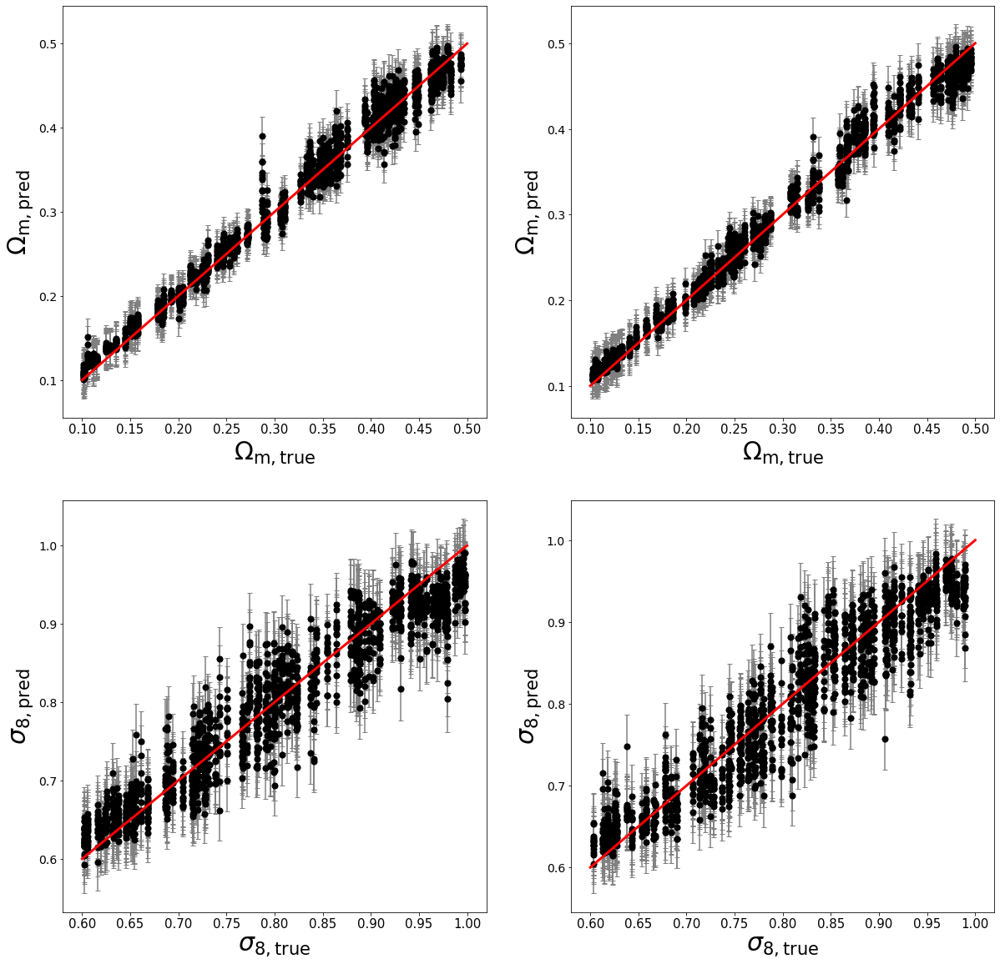

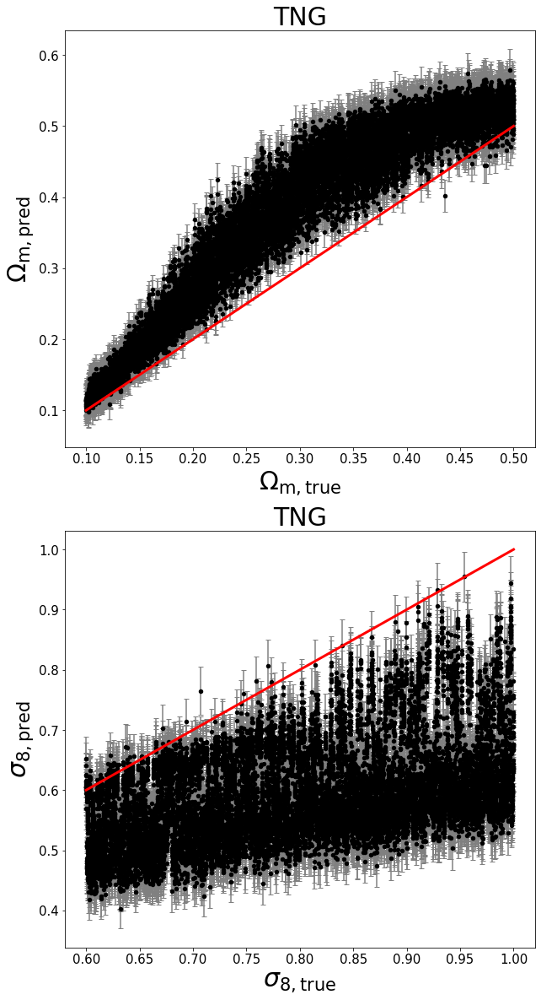

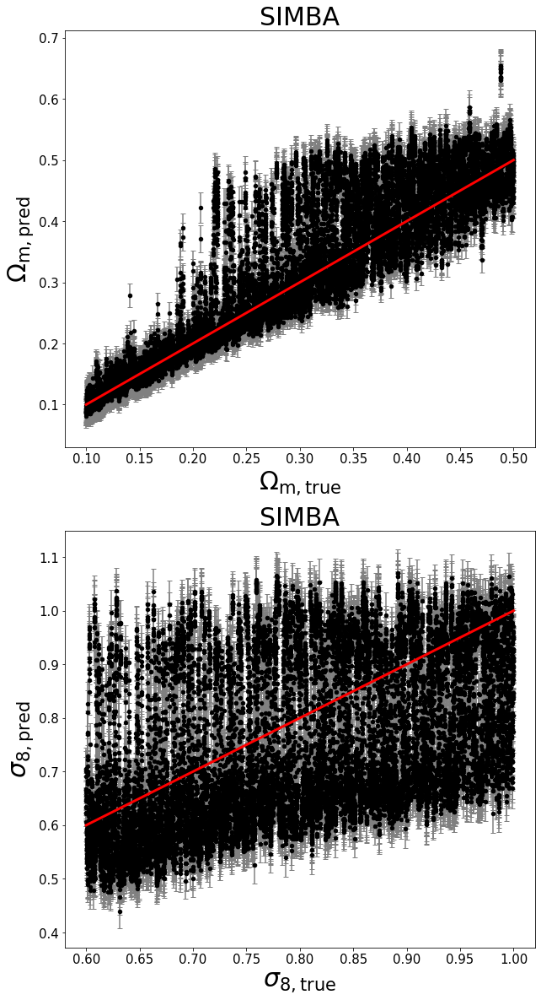

In [17]:
sim  = ['ASTRID', 'EAGLE']; field = 'HI'
study_name = 'ASTRID_EAGLE_HI_cnn_zero_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('SIMBA', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=5.962%, R2 score=0.969,chi2=0.761, bias=-0.001
$\sigma_8$: MSE=0.004, % error=6.686%, R2 score=0.653,chi2=1.007, bias=0.005
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.009, % error=30.404%, R2 score=0.295,chi2=12.955, bias=-0.084
$\sigma_8$: MSE=0.014, % error=11.415%, R2 score=-0.060,chi2=4.224, bias=0.061
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.008, % error=29.560%, R2 score=0.436,chi2=10.498, bias=-0.077
$\sigma_8$: MSE=0.010, % error=9.918%, R2 score=0.255,chi2=2.490, bias=0.016


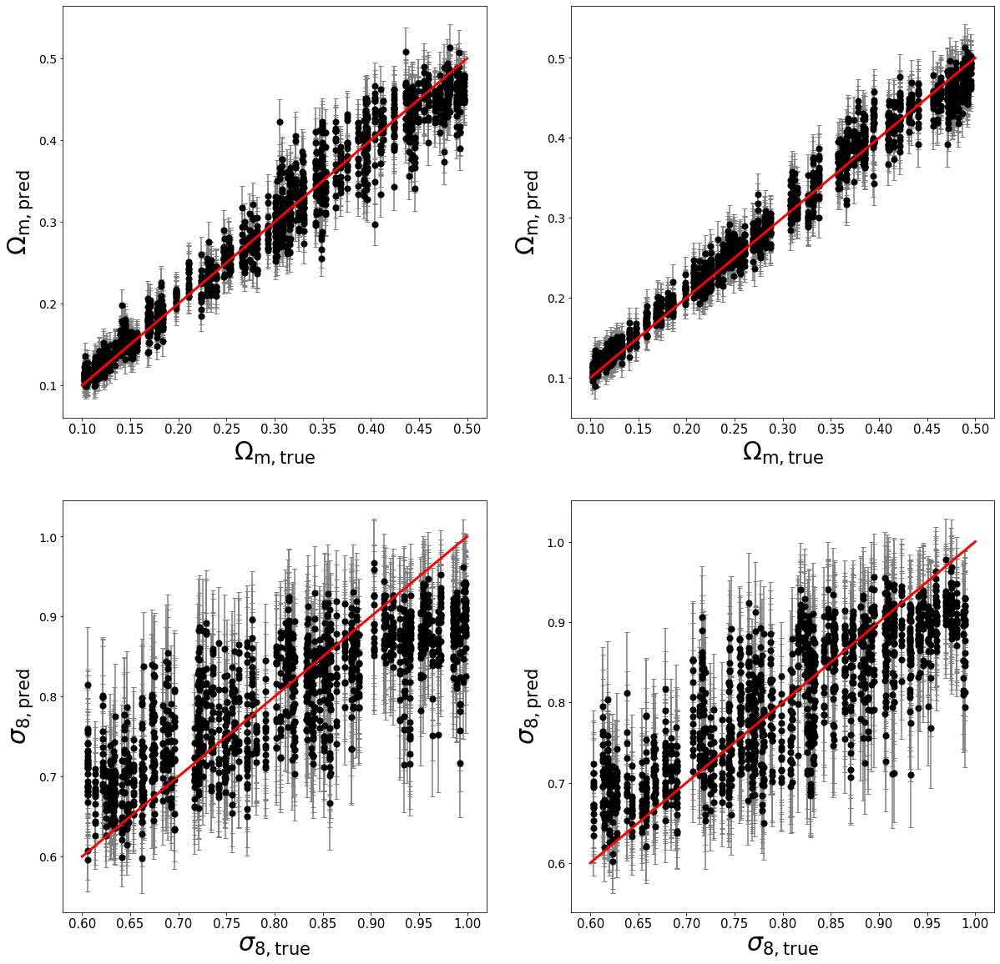

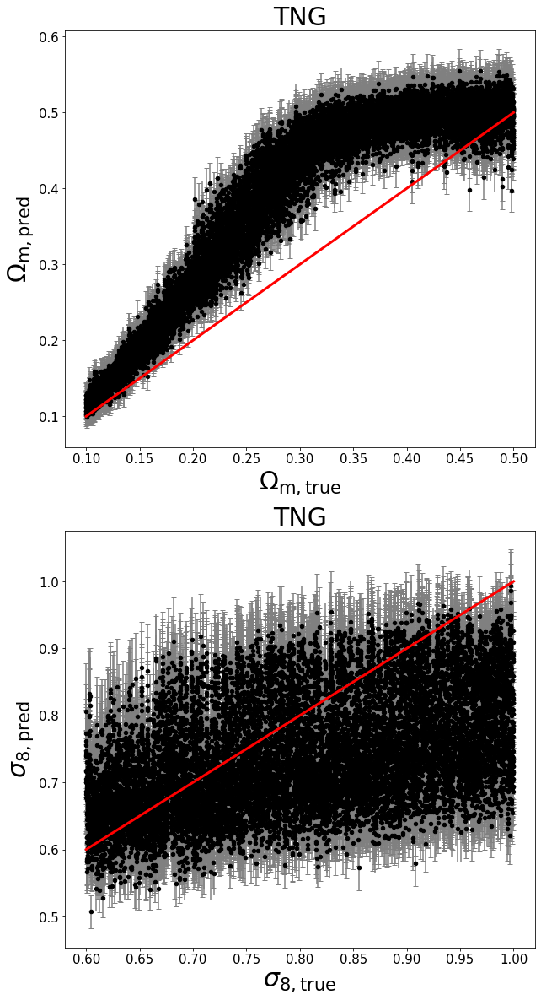

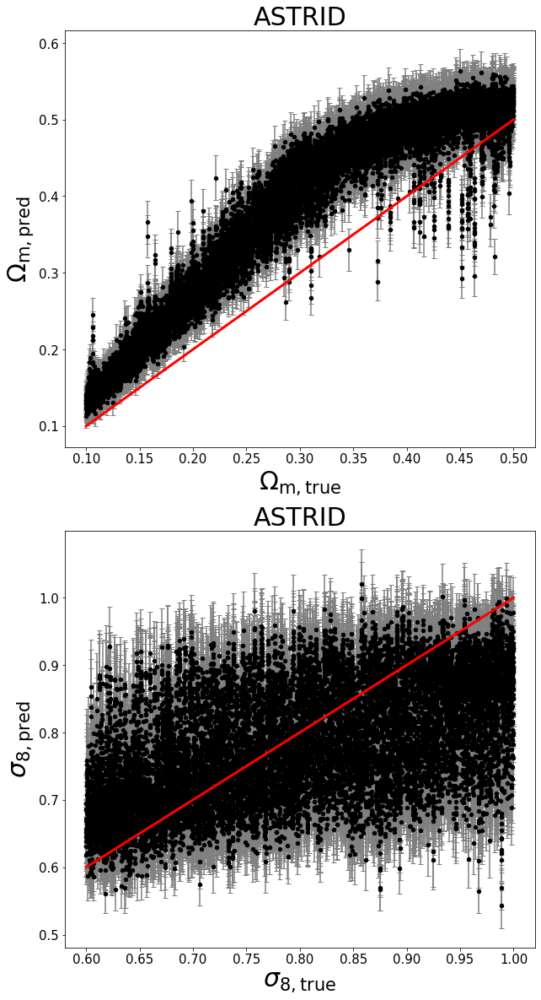

In [15]:
sim  = ['SIMBA', 'EAGLE']; field = 'HI'
study_name = 'SIMBA_EAGLE_HI_cnn_mid_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('ASTRID', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=4.360%, R2 score=0.982,chi2=0.692, bias=-0.001
$\sigma_8$: MSE=0.002, % error=4.622%, R2 score=0.828,chi2=1.214, bias=0.001
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.014, % error=36.624%, R2 score=-0.055,chi2=27.953, bias=-0.107
$\sigma_8$: MSE=0.024, % error=15.142%, R2 score=-0.805,chi2=14.417, bias=0.107
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.007, % error=27.438%, R2 score=0.467,chi2=15.016, bias=-0.077
$\sigma_8$: MSE=0.017, % error=14.112%, R2 score=-0.261,chi2=8.773, bias=-0.078


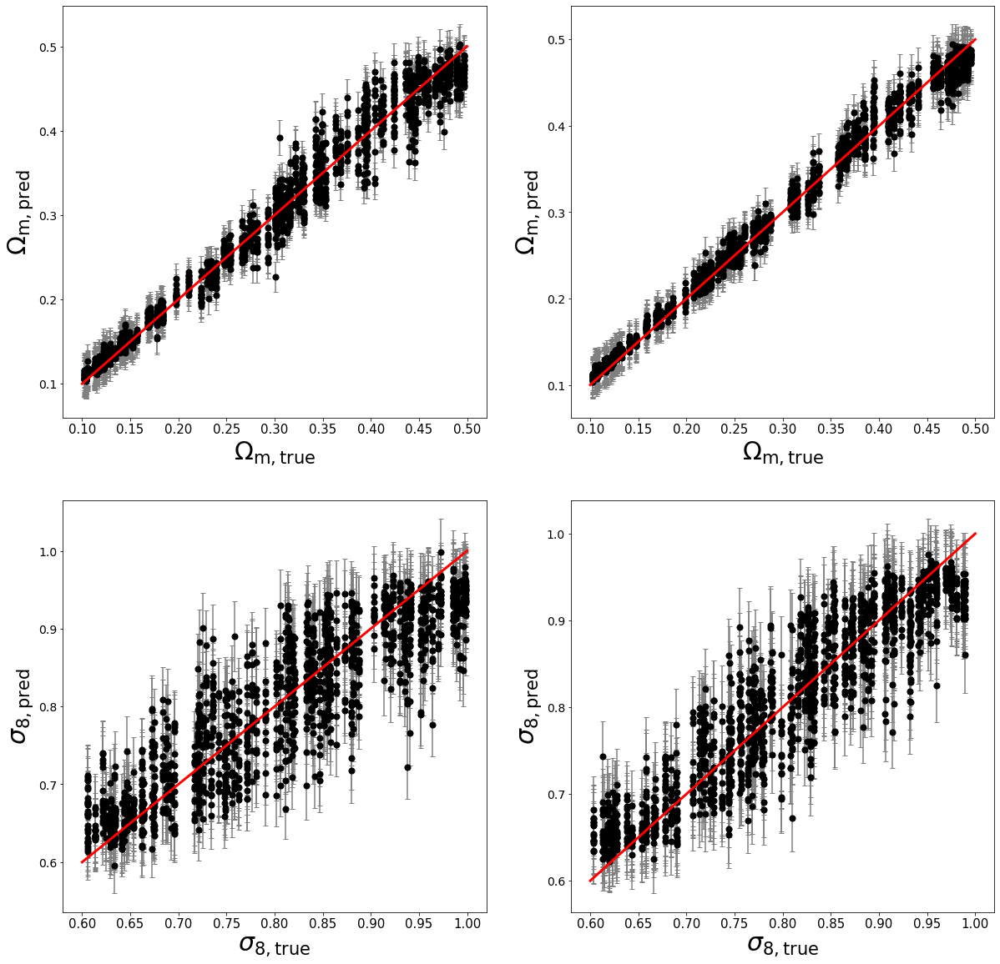

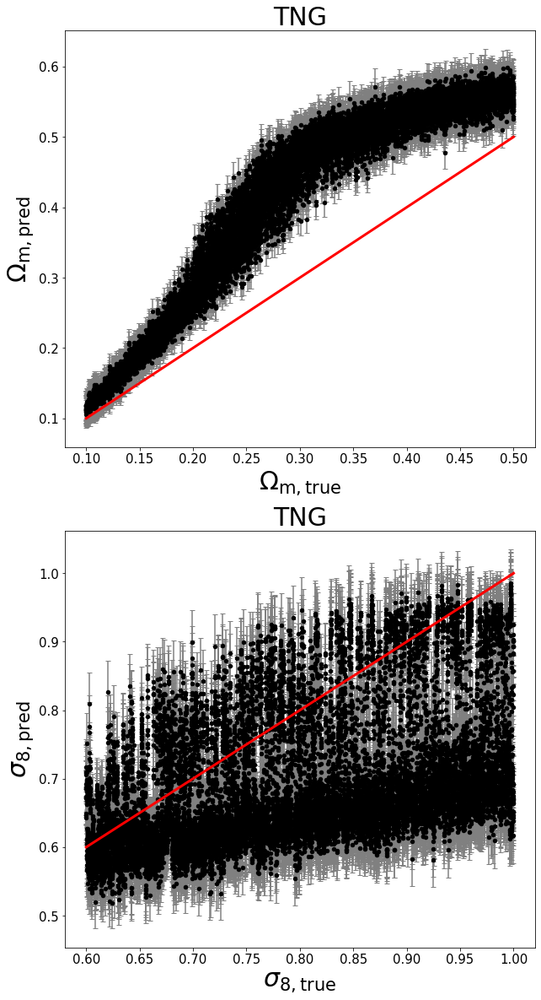

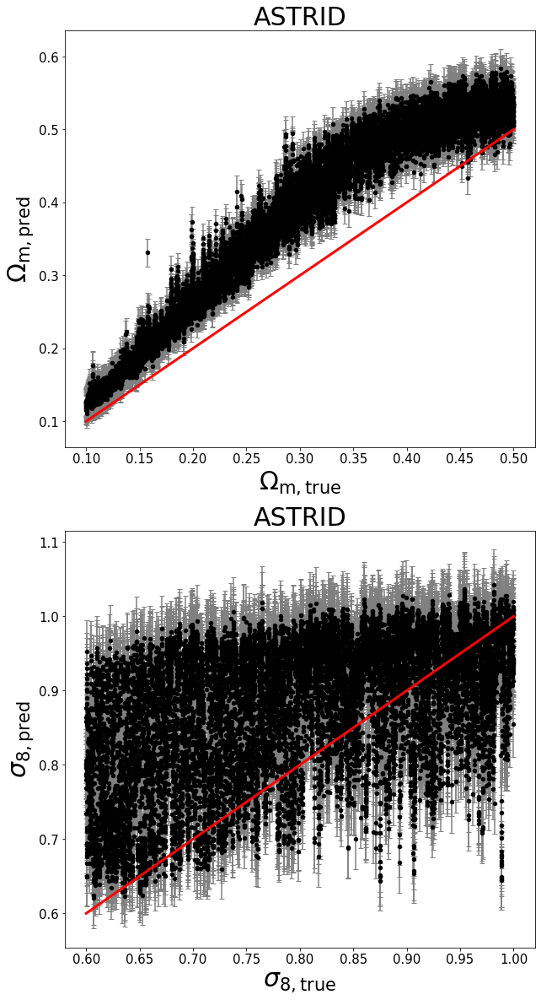

In [13]:
sim  = ['SIMBA', 'EAGLE']; field = 'HI'
study_name = 'SIMBA_EAGLE_HI_cnn_zero_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('TNG', show_score=True)
mist.test_on_cnn('ASTRID', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=3.990%, R2 score=0.985,chi2=0.353, bias=0.001
$\sigma_8$: MSE=0.002, % error=4.466%, R2 score=0.845,chi2=1.103, bias=-0.005
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.009, % error=22.128%, R2 score=0.359,chi2=14.629, bias=0.045
$\sigma_8$: MSE=0.023, % error=16.053%, R2 score=-0.719,chi2=11.859, bias=-0.090
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.002, % error=11.446%, R2 score=0.837,chi2=3.130, bias=-0.026
$\sigma_8$: MSE=0.007, % error=8.596%, R2 score=0.463,chi2=4.017, bias=-0.019


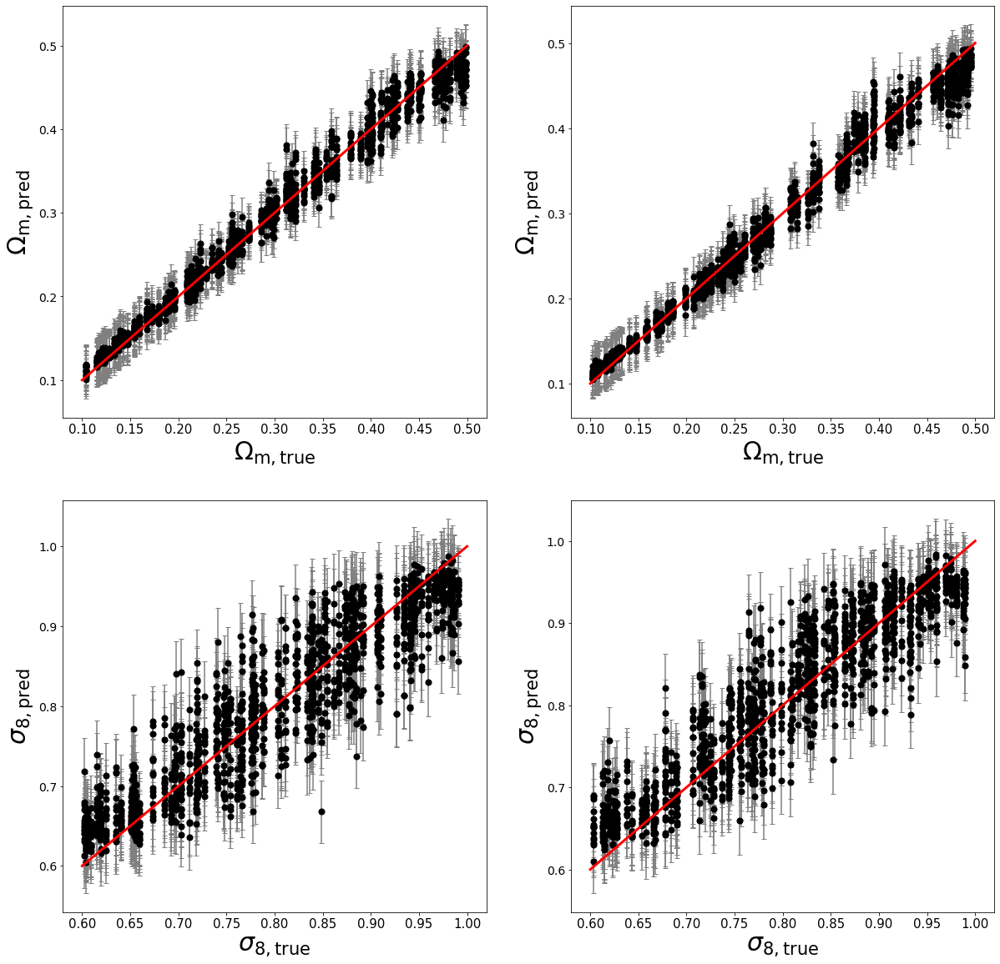

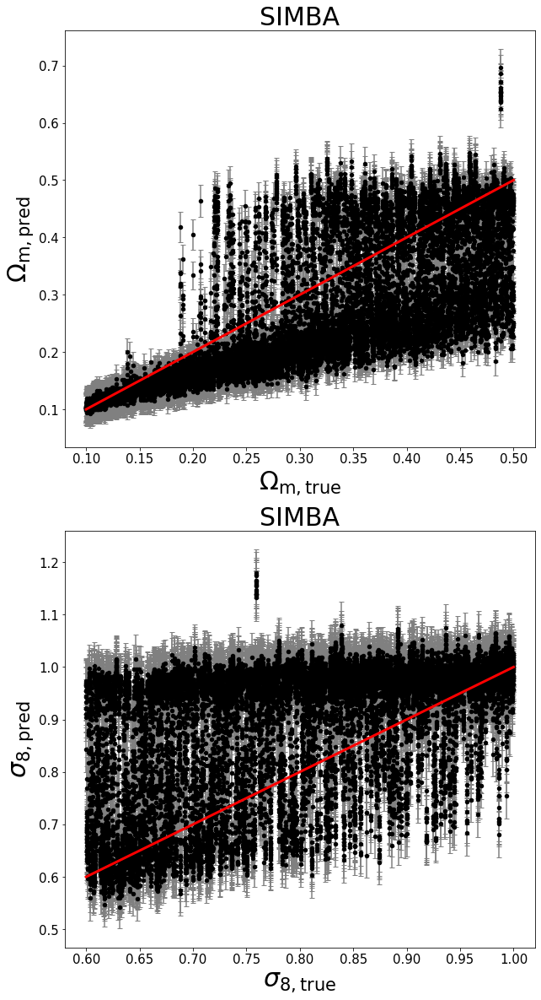

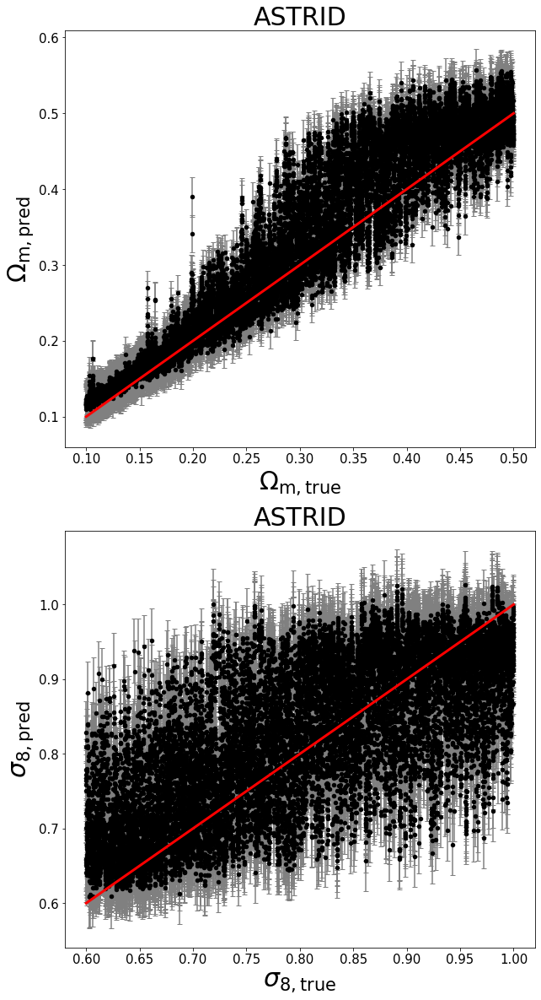

In [10]:
sim  = ['TNG', 'EAGLE']; field = 'HI'
study_name = 'TNG_EAGLE_HI_cnn_zero_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn( save_plot=True, fname="eagle")
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('SIMBA', show_score=True)
mist.test_on_cnn('ASTRID', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=4.944%, R2 score=0.979,chi2=0.448, bias=-0.001
$\sigma_8$: MSE=0.002, % error=4.852%, R2 score=0.822,chi2=0.765, bias=-0.003
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.008, % error=22.087%, R2 score=0.364,chi2=12.607, bias=0.053
$\sigma_8$: MSE=0.051, % error=24.209%, R2 score=-2.823,chi2=27.102, bias=-0.160
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.002, % error=11.684%, R2 score=0.839,chi2=2.787, bias=-0.026
$\sigma_8$: MSE=0.007, % error=8.462%, R2 score=0.479,chi2=2.339, bias=-0.008


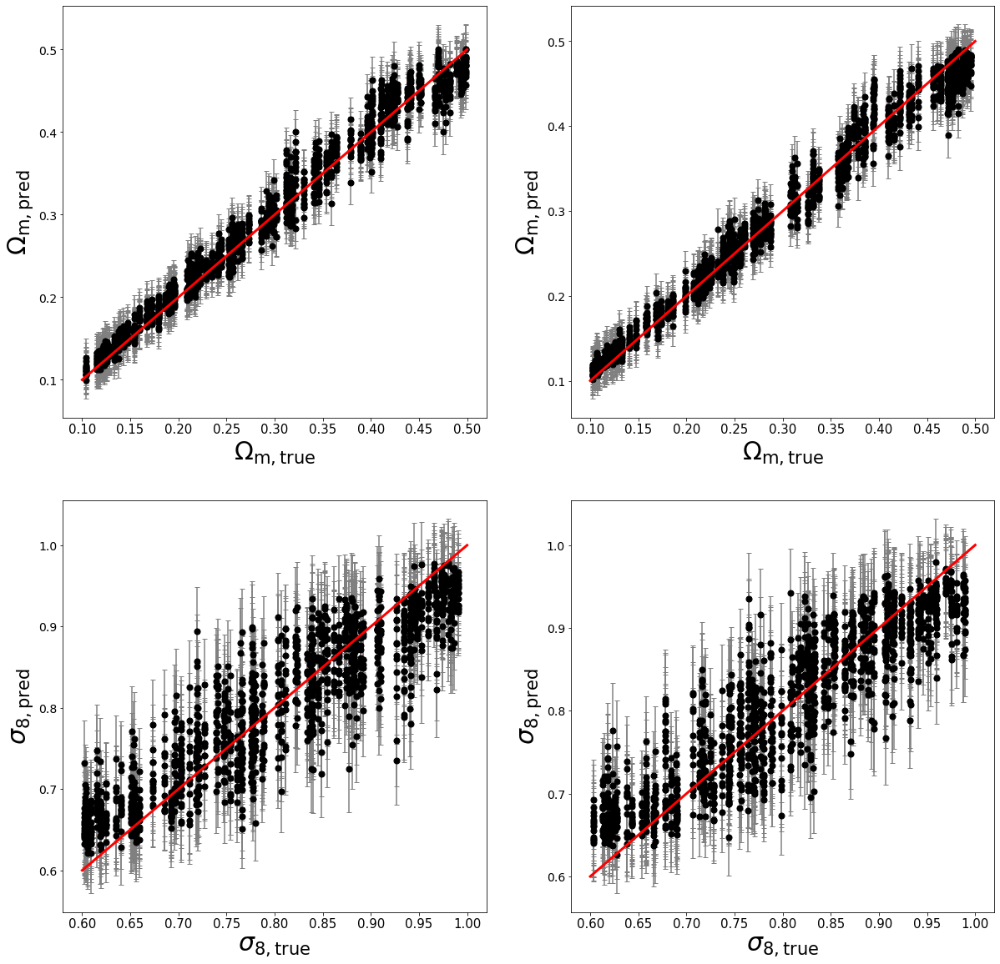

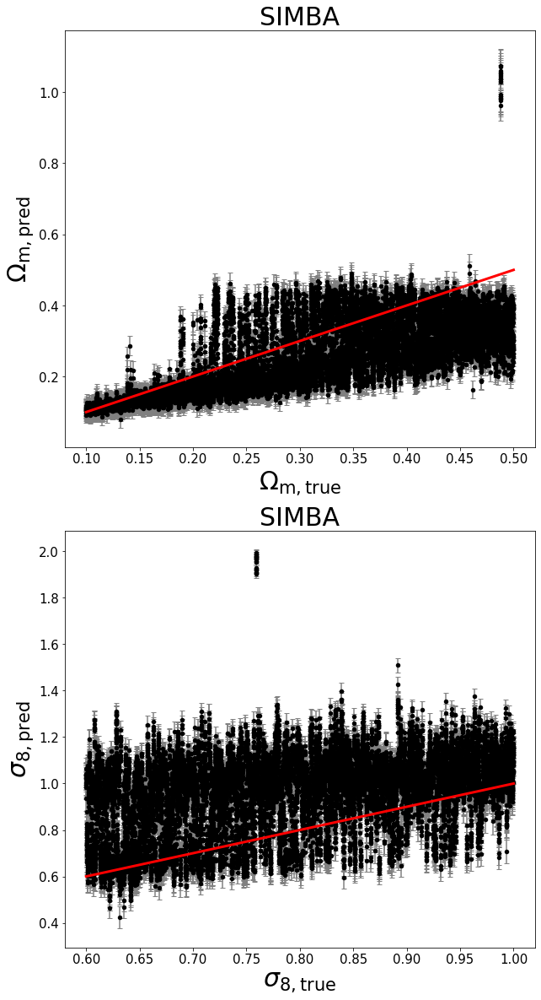

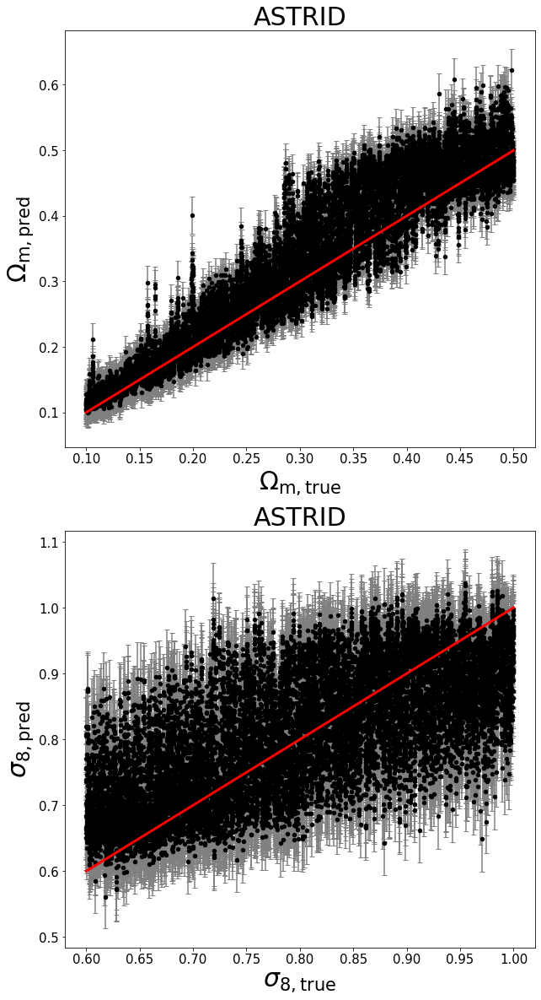

In [7]:
sim  = ['TNG', 'EAGLE']; field = 'HI'
study_name = 'TNG_EAGLE_HI_cnn_mid_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn( save_plot=False, fname="eagle")
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
#mist.test_on_cnn('TNG', show_score=True)
#mist.test_on_cnn('EAGLE', show_score=True)
mist.test_on_cnn('SIMBA', show_score=True)
mist.test_on_cnn('ASTRID', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.001, % error=9.205%, R2 score=0.922,chi2=0.781, bias=-0.016
$\sigma_8$: MSE=0.007, % error=8.751%, R2 score=0.447,chi2=2.210, bias=-0.000
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.001, % error=6.819%, R2 score=0.950,chi2=0.513, bias=-0.003
$\sigma_8$: MSE=0.008, % error=9.169%, R2 score=0.417,chi2=2.285, bias=-0.009
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.008, % error=31.995%, R2 score=0.365,chi2=6.036, bias=-0.084
$\sigma_8$: MSE=0.011, % error=10.048%, R2 score=0.157,chi2=3.428, bias=0.062


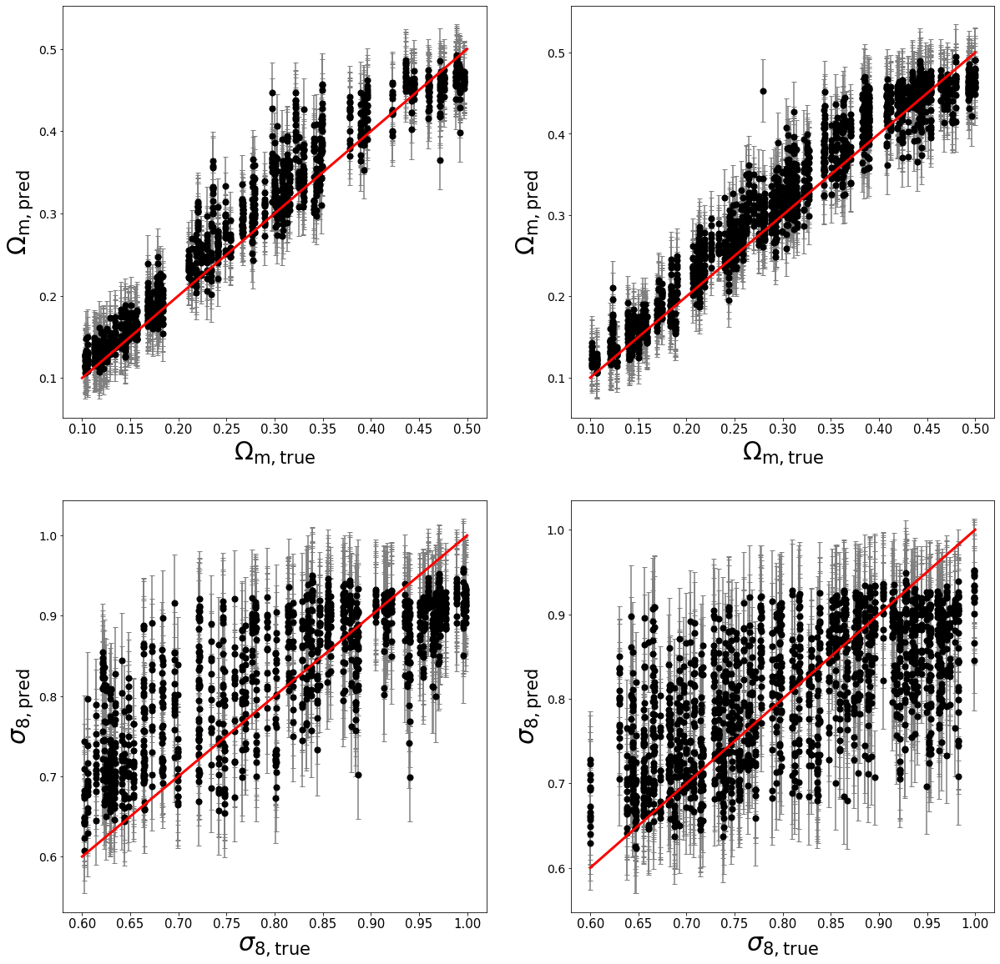

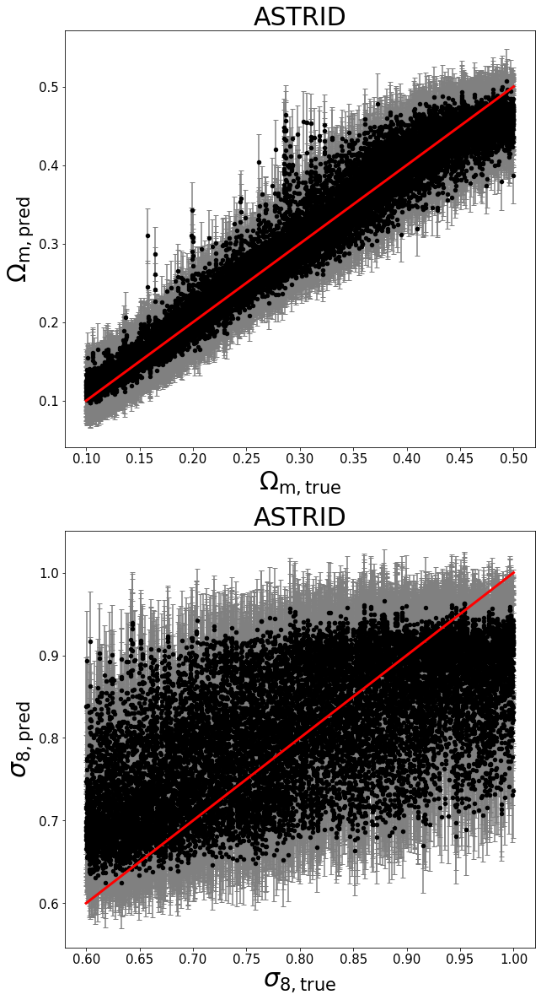

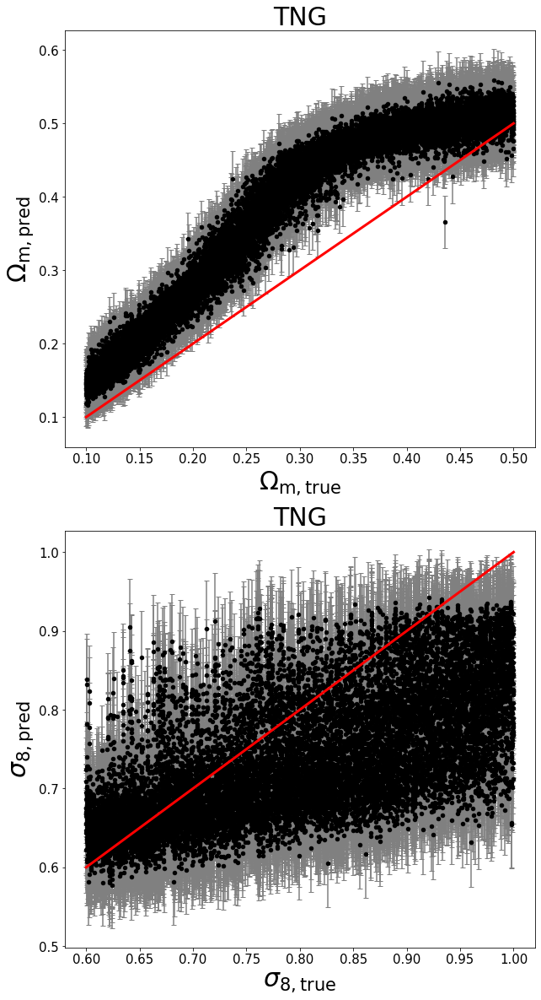

In [13]:
sim  = ['SIMBA', 'TNG_SB']; field = 'HI'
study_name = 'SIMBA_TNG_SB_HI_cnn_zero_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
mist.test_on_cnn('TNG', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.002, % error=11.206%, R2 score=0.872,chi2=1.036, bias=-0.008
$\sigma_8$: MSE=0.007, % error=8.650%, R2 score=0.448,chi2=1.480, bias=0.007
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.003, % error=12.834%, R2 score=0.788,chi2=1.784, bias=0.032
$\sigma_8$: MSE=0.012, % error=10.539%, R2 score=0.124,chi2=2.352, bias=0.040
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.006, % error=27.091%, R2 score=0.556,chi2=3.580, bias=-0.064
$\sigma_8$: MSE=0.009, % error=8.956%, R2 score=0.347,chi2=1.809, bias=0.045


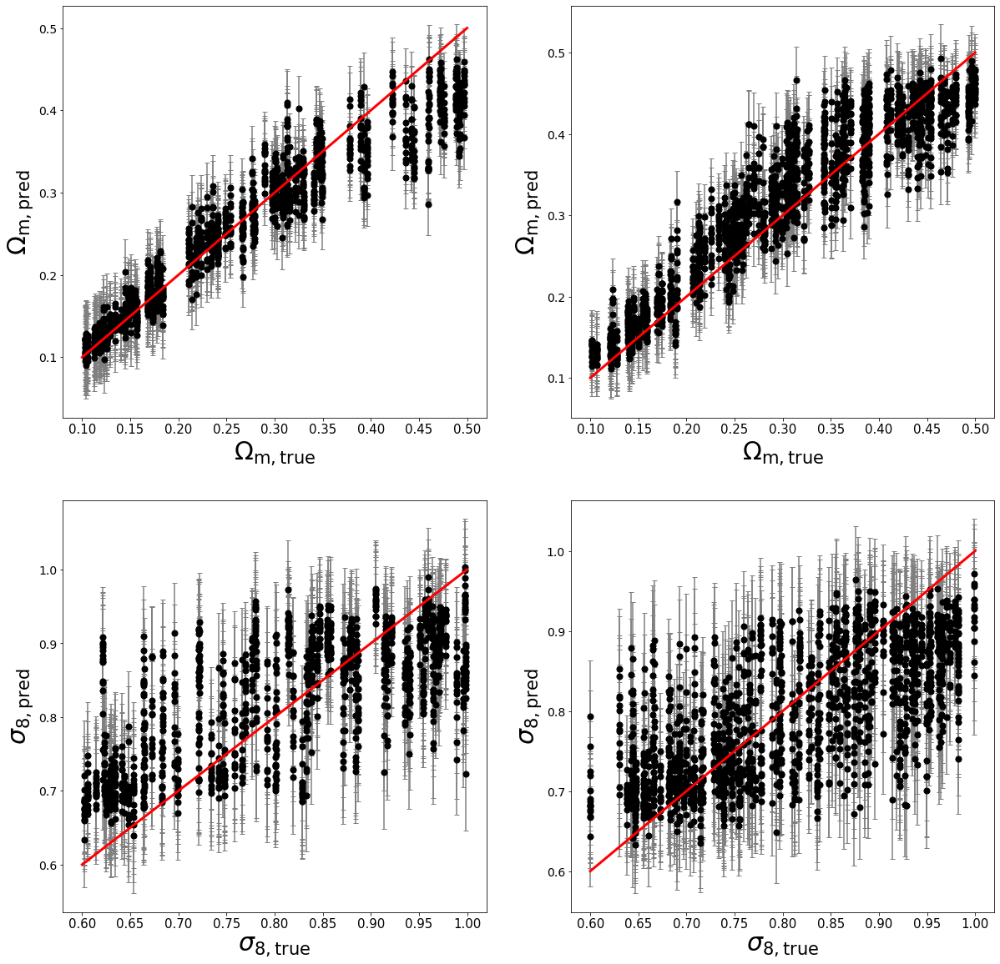

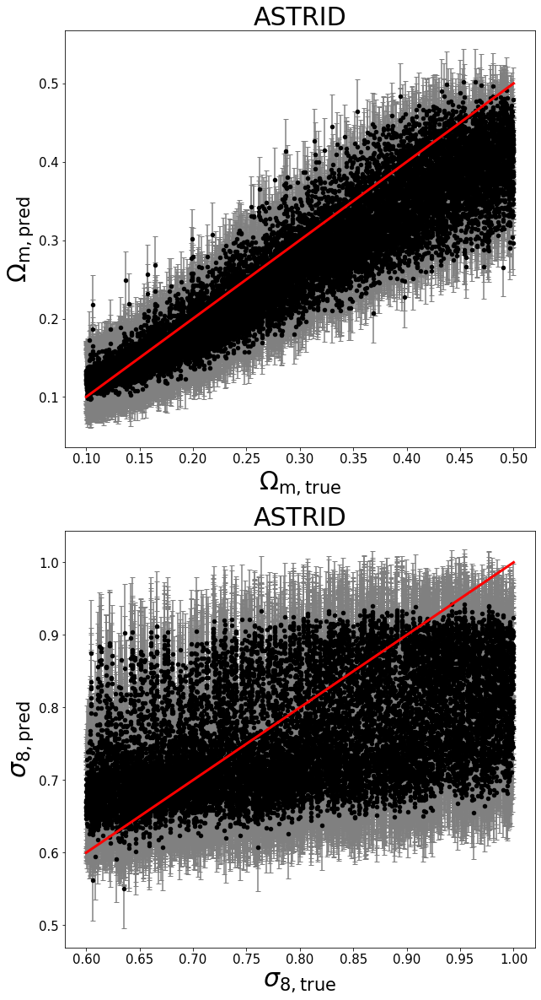

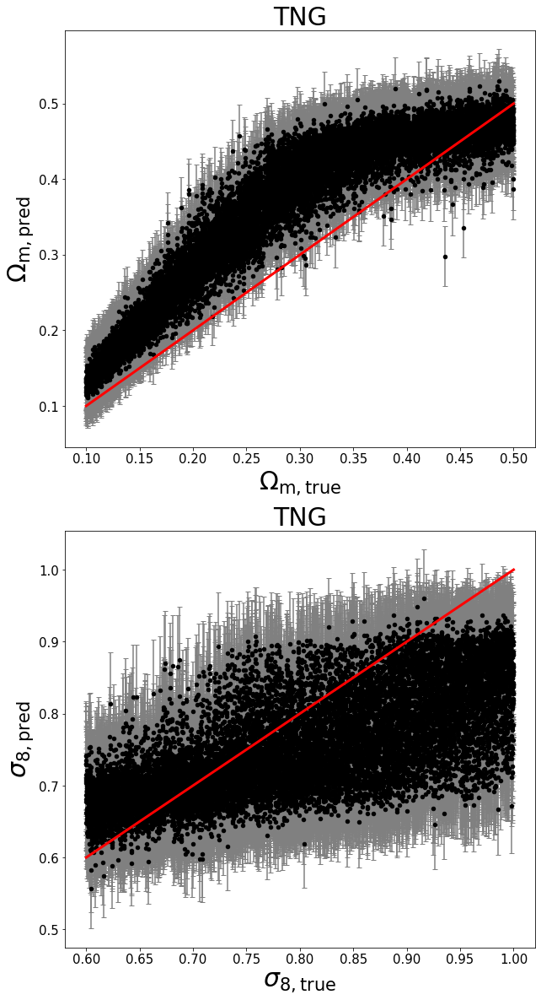

In [17]:
sim  = ['SIMBA', 'TNG_SB']; field = 'HI'
study_name = 'SIMBA_TNG_SB_HI_cnn_mid_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
mist.test_on_cnn('TNG', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.005, % error=23.444%, R2 score=0.592,chi2=4.545, bias=-0.031
$\sigma_8$: MSE=0.014, % error=12.902%, R2 score=-0.055,chi2=1.167, bias=0.011
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.007, % error=27.868%, R2 score=0.485,chi2=6.004, bias=-0.050
$\sigma_8$: MSE=0.014, % error=13.152%, R2 score=-0.059,chi2=1.128, bias=-0.007
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.012, % error=39.121%, R2 score=0.101,chi2=10.584, bias=-0.083
$\sigma_8$: MSE=0.014, % error=13.185%, R2 score=-0.067,chi2=1.116, bias=-0.007


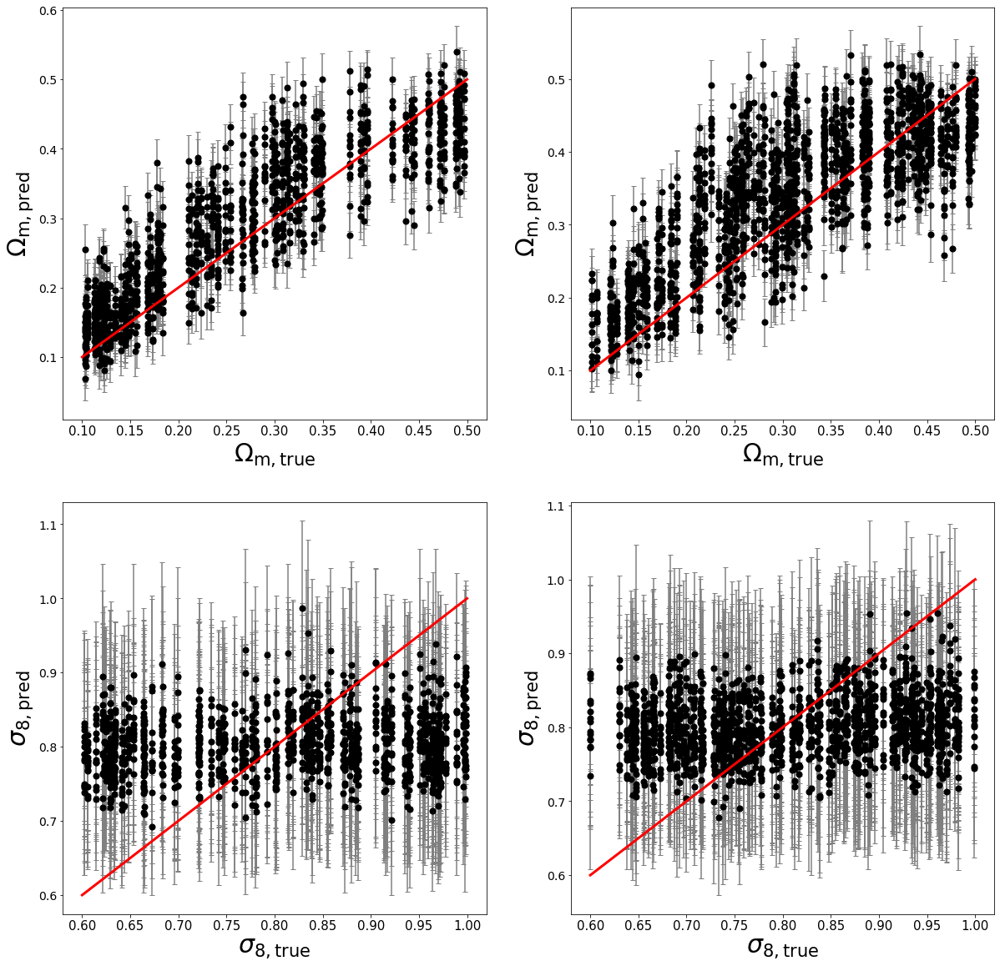

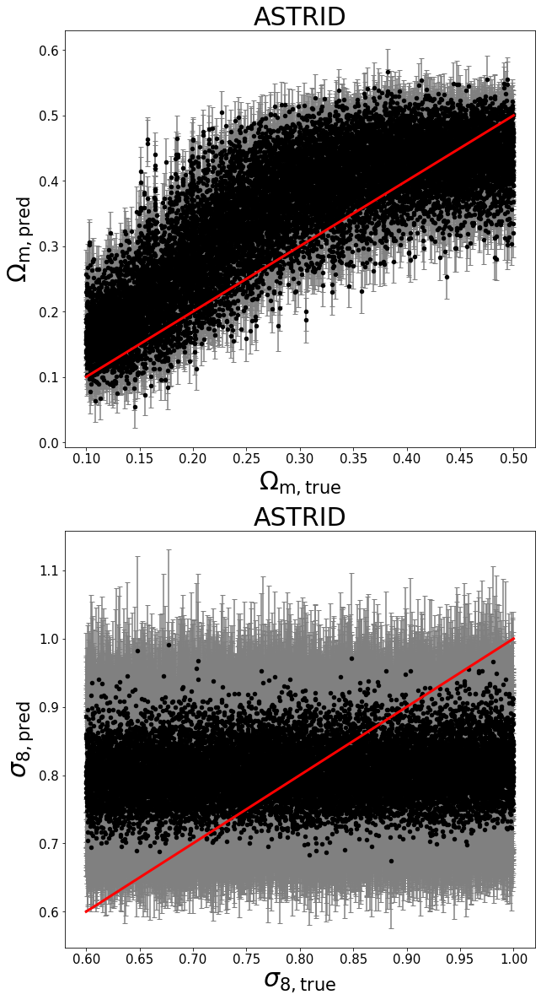

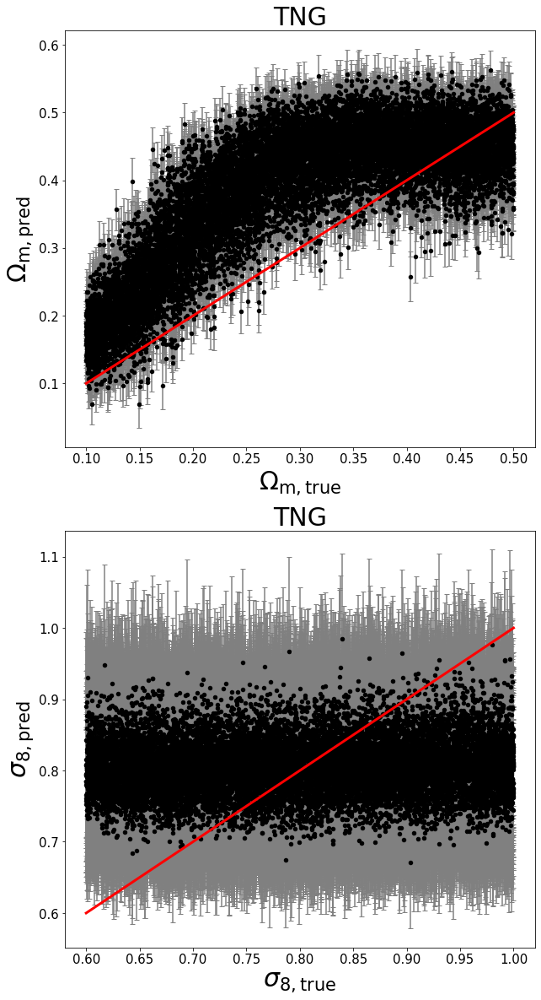

In [18]:
sim  = ['SIMBA', 'TNG_SB']; field = 'HI'
study_name = 'SIMBA_TNG_SB_HI_cnn_high_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
mist.test_on_cnn('TNG', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

In [1]:
sim  = ['ASTRID', 'TNG_SB']; field = 'HI'
study_name = 'ASTRID_TNG_SB_HI_cnn_mid_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=16, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('SIMBA', show_score=True)
mist.test_on_cnn('TNG', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

NameError: name 'MIST' is not defined

$\Omega_m$: MSE=0.002, % error=10.472%, R2 score=0.881,chi2=1.633, bias=0.018
$\sigma_8$: MSE=0.013, % error=12.331%, R2 score=-0.009,chi2=0.987, bias=0.011
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.001, % error=7.313%, R2 score=0.947,chi2=0.688, bias=0.013
$\sigma_8$: MSE=0.013, % error=12.895%, R2 score=0.001,chi2=1.004, bias=0.000
(15000, 1, 256, 256) (15000, 2)
$\Omega_m$: MSE=0.003, % error=16.615%, R2 score=0.808,chi2=2.616, bias=-0.036
$\sigma_8$: MSE=0.013, % error=12.902%, R2 score=0.000,chi2=0.996, bias=0.000


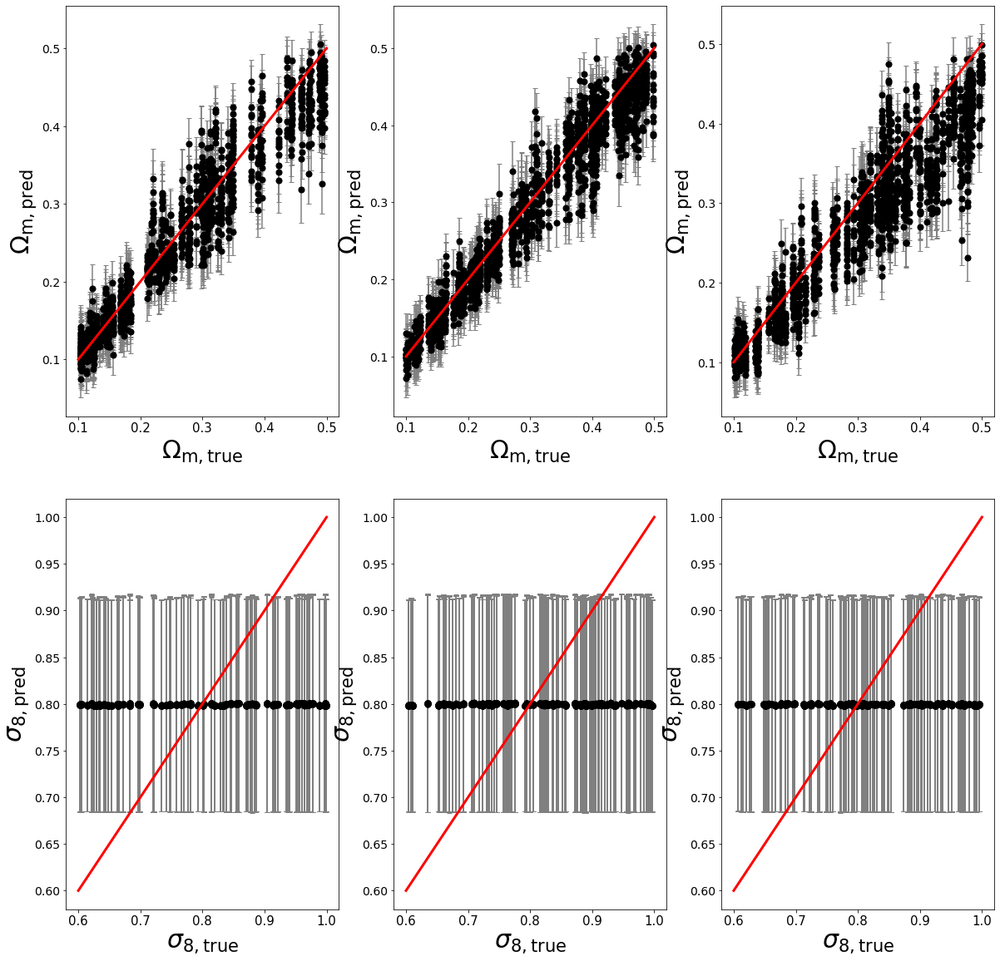

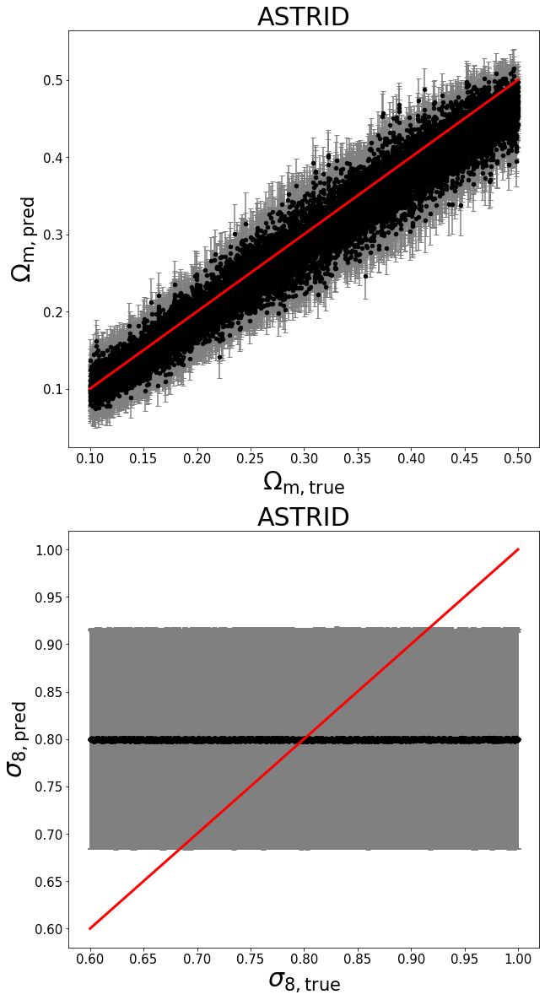

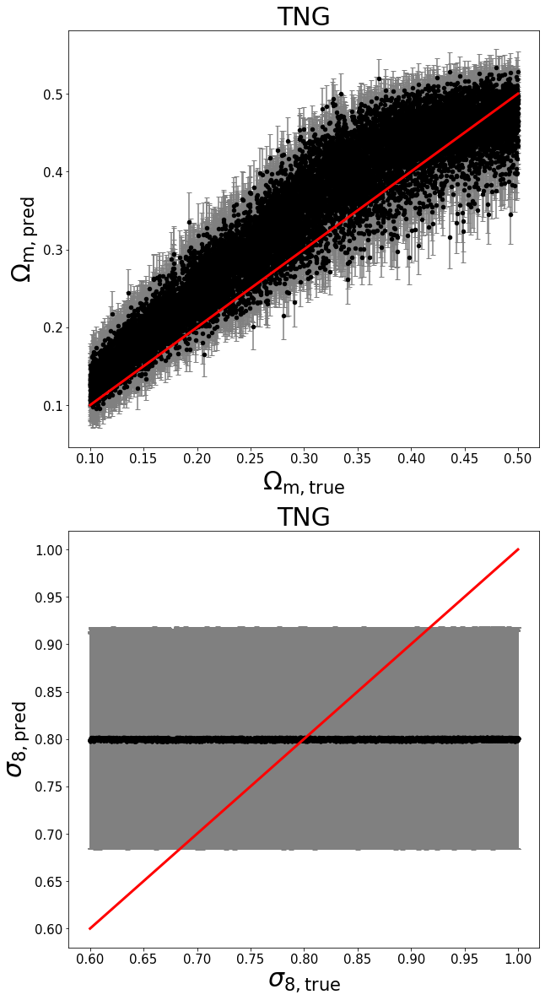

In [4]:
sim  = ['SIMBA', 'ASTRID', 'TNG_SB']; field = 'HI'
study_name = 'SIMBA_ASTRID_TNG_SB_HI_cnn_high_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
mist.test_on_cnn('TNG', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

In [ ]:
sim  = ['SIMBA', 'ASTRID', 'TNG_SB']; field = 'HI'
study_name = 'SIMBA_ASTRID_TNG_SB_HI_cnn_high_monopole_1_new_split'
#study_name = "SIMBA_TNG_SB_HI_cnn_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
mist.test_on_cnn('TNG', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')